In [17]:
from keras import Input, layers, backend, Model, losses, datasets, models, metrics, optimizers, initializers
from keras.utils import Sequence
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import os
import math

In [18]:

class FelixSequence(Sequence):
    def __init__(self, x_set, y_set, batch_size):
        """Here self.x is a list of paths to .npy input files. self.y is a
        corresponding list of paths to .npy output files."""
        self.x, self.y = x_set, y_set
        self.batch_size = batch_size

    def __len__(self):
        return int(np.ceil(len(self.x) / float(self.batch_size)))

    def __getitem__(self, idx):
        batch_x = self.x[idx * self.batch_size:(idx + 1) * self.batch_size]
        batch_y = self.y[idx * self.batch_size:(idx + 1) * self.batch_size]
        #print(np.array([np.load(file_name) for file_name in batch_x]).shape, np.array([np.load(file_name) for file_name in batch_y]).shape)
        return np.array([np.reshape(np.load(file_name), (128, 128, 1)) for file_name in batch_x]), np.array([np.reshape(np.load(file_name), (128, 128, 1)) for file_name in batch_y])
    

def gen_paths_labels(base_path = "D:\\Uni Work\\Masters Project\\electron_dists\\Data\\VAE_000_1\\Data"):
    """A generator to yield (data-paths, corresponding labels) tuples for each
    segment of data (typically training, validation, and testing)."""
    for segment in sorted(os.listdir(base_path)):
        segment_path = os.path.join(base_path, segment)
        input_paths = []
        output_paths = []
        for crystal in sorted(os.listdir(segment_path)):
            crystal_path = os.path.join(segment_path, crystal)
            files = sorted(os.listdir(crystal_path))
            input_paths.append(os.path.join(crystal_path, files[0]))
            output_paths.append(os.path.join(crystal_path, files[1]))
        yield [input_paths, output_paths]

def gen_paths_fromfile(Path):
    input_paths = []
    output_paths = []
    with open(Path) as textFile:
        lines = [line.split() for line in textFile]
    #print(lines)
    for i in lines:
        output_paths.append(i[0])
        input_paths.append(i[0].split("Output.npy")[0] + "Input.npy")
    return([input_paths, output_paths])

In [19]:
latent_dim = 10

"""
## Create a sampling layer
"""
class Sampling(layers.Layer):
    """Uses (z_mean, z_log_var) to sample z, the vector encoding a digit."""

    def call(self, inputs):
        z_mean, z_log_var = inputs
        batch = tf.shape(z_mean)[0]
        dim = tf.shape(z_mean)[1]
        epsilon = tf.keras.backend.random_normal(shape=(batch, dim))
        return z_mean + tf.exp(0.5 * z_log_var) * epsilon


In [20]:
"""
## Build the encoder
"""
encoder_inputs = Input(shape=(128, 128, 1))
x = layers.Conv2D(32, kernel_size = (3, 3), activation="relu", strides=2, padding="same")(encoder_inputs)
x = layers.Conv2D(64, kernel_size = (3, 3), activation="relu", strides=2, padding="same")(x)
x = layers.Flatten()(x)
x = layers.Dense(16, activation="relu")(x)
#x = layers.Dropout(0.25)(x) #APPARANTLY THEY ARE BAD
z_mean = layers.Dense(latent_dim, name="z_mean")(x)
z_log_var = layers.Dense(latent_dim, name="z_log_var", kernel_initializer='zeros', bias_initializer='zeros')(x)
z = Sampling()([z_mean, z_log_var])
encoder = Model(encoder_inputs, [z_mean, z_log_var, z], name="encoder")
encoder.summary()

Model: "encoder"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_7 (InputLayer)            [(None, 128, 128, 1) 0                                            
__________________________________________________________________________________________________
conv2d_12 (Conv2D)              (None, 64, 64, 32)   320         input_7[0][0]                    
__________________________________________________________________________________________________
conv2d_13 (Conv2D)              (None, 32, 32, 64)   18496       conv2d_12[0][0]                  
__________________________________________________________________________________________________
flatten_2 (Flatten)             (None, 65536)        0           conv2d_13[0][0]                  
____________________________________________________________________________________________

In [21]:
"""
## Build the decoder
"""


latent_inputs = Input(shape=(latent_dim,))
x = layers.Dense(32 * 32 * 64, activation="relu")(latent_inputs)
x = layers.Reshape((32, 32, 64))(x)
x = layers.Conv2DTranspose(128, kernel_size = (3, 3), activation="relu", strides=2, padding="same")(x)
x = layers.Conv2DTranspose(64, kernel_size = (3, 3), activation="relu", strides=2, padding="same")(x)
decoder_outputs = layers.Conv2DTranspose(1, kernel_size = (2, 2), activation="relu", padding="same")(x)
decoder = Model(latent_inputs, decoder_outputs, name="decoder")

decoder.summary()




Model: "decoder"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_8 (InputLayer)         [(None, 10)]              0         
_________________________________________________________________
dense_5 (Dense)              (None, 65536)             720896    
_________________________________________________________________
reshape_2 (Reshape)          (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_transpose_6 (Conv2DTr (None, 64, 64, 128)       73856     
_________________________________________________________________
conv2d_transpose_7 (Conv2DTr (None, 128, 128, 64)      73792     
_________________________________________________________________
conv2d_transpose_8 (Conv2DTr (None, 128, 128, 1)       257       
Total params: 868,801
Trainable params: 868,801
Non-trainable params: 0
_____________________________________________________

In [22]:
#RESNET Section

#with strategy.scope():
resnet_inputs = Input(shape=(128, 128, 1))
layer1 = layers.Conv2D(128, (3, 3), activation='relu', padding = "same")(resnet_inputs)
block_1_output = layer1

layer2 = layers.Conv2D(128, (3, 3), activation='relu', padding = "same")(block_1_output)
block_2_output = layers.add([layer2, block_1_output])

layer3 = layers.Conv2D(128, (3, 3), activation='relu', padding = "same")(block_2_output)
block_3_output = layers.add([layer3, block_2_output])

resnet_outputs = layers.Conv2D(1, (3, 3), activation='relu', padding = "same")(block_3_output)

resnet = Model(resnet_inputs, resnet_outputs, name="resnet")

resnet.summary()


Model: "resnet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_9 (InputLayer)            [(None, 128, 128, 1) 0                                            
__________________________________________________________________________________________________
conv2d_14 (Conv2D)              (None, 128, 128, 128 1280        input_9[0][0]                    
__________________________________________________________________________________________________
conv2d_15 (Conv2D)              (None, 128, 128, 128 147584      conv2d_14[0][0]                  
__________________________________________________________________________________________________
add_4 (Add)                     (None, 128, 128, 128 0           conv2d_15[0][0]                  
                                                                 conv2d_14[0][0]             

In [23]:
class VAE(Model):
    def __init__(self, encoder, decoder, resnet, **kwargs):
        super(VAE, self).__init__(**kwargs)
        self.encoder = encoder
        self.decoder = decoder
        self.resnet = resnet
        self.total_loss_tracker = metrics.Mean(name="total_loss")
        self.reconstruction_loss_tracker = metrics.Mean(
            name="reconstruction_loss"
        )
        self.kl_loss_tracker = metrics.Mean(name="kl_loss")
        self.res_loss_tracker = metrics.Mean(name="res_loss")

    @property
    def metrics(self):
        return [
            self.total_loss_tracker,
            self.reconstruction_loss_tracker,
            self.kl_loss_tracker,
            self.res_loss_tracker
        ]

    def train_step(self, data):
        x, y = data
        with tf.GradientTape(persistent=True) as tape:
            z_mean, z_log_var, z = self.encoder(x)
            reconstruction = self.decoder(z)
            reconstruction_loss = tf.reduce_mean(
                tf.reduce_sum(
                losses.mean_squared_logarithmic_error(y, reconstruction), axis=(1, 2)
                )
            )
            #print(z_mean, z_log_var, z)
            kl_loss = -0.5 * (1 + z_log_var - tf.square(z_mean) - tf.exp(z_log_var))
            kl_loss = tf.reduce_mean(tf.reduce_sum(kl_loss, axis=1))
            total_loss = reconstruction_loss + kl_loss
            
            sharp_recon = self.resnet(reconstruction)
            sharp_recon_loss = tf.reduce_mean(
                tf.reduce_sum(
                losses.mean_absolute_error(y, sharp_recon), axis=(1, 2)
                )
            )
            
        grads = tape.gradient(total_loss, self.trainable_weights)
        self.optimizer.apply_gradients(zip(grads, self.trainable_weights))
        self.total_loss_tracker.update_state(total_loss)
        self.reconstruction_loss_tracker.update_state(reconstruction_loss)
        self.kl_loss_tracker.update_state(kl_loss)
        
        resnet_grads = tape.gradient(sharp_recon_loss, self.resnet.trainable_weights)
        self.optimizer.apply_gradients(zip(resnet_grads, self.resnet.trainable_weights))
        self.res_loss_tracker.update_state(sharp_recon_loss)

        return {
            "loss": self.total_loss_tracker.result(),
            "reconstruction_loss": self.reconstruction_loss_tracker.result(),
            "kl_loss": self.kl_loss_tracker.result(),
            "res_loss": self.res_loss_tracker.result()
        }

    def call(self, data):
        return self.resnet(self.decoder(self.encoder(data)[2]))

#losses.MSE(y, reconstruction), axis=(1, 2)
#losses.mean_squared_logarithmic_error(y, reconstruction), axis=(1, 2)

In [24]:
#vae = models.load_model("/home/ug-ml/felix-ML/VAE_000/Data/Models/VAE_3")

vae = VAE(encoder, decoder, resnet)
#vae.add_metric(trainable_metric(vae), name="testMetric")
vae.compile(optimizer=optimizers.Adam())

#resnet.compile(optimizer=optimizers.RMSprop(), losses.MeanAbsoluteError())

batch_size=64
#data_path = "/home/ug-ml/felix-ML/VAE_000/Data/FilePaths/"
data_path = "/home/ug-ml/felix-ML/VAE_000/Data/Data/"

data = [i for i in gen_paths_labels(data_path)]

val_seq = FelixSequence(data[2][0], data[2][1], batch_size)
train_seq = FelixSequence(data[1][0], data[1][1], batch_size)
test_seq = FelixSequence(data[0][0], data[0][1], batch_size)

#ValidationPaths = gen_paths_fromfile(data_path + "Validation_50.txt")
#TrainingPaths = gen_paths_fromfile(data_path + "Training_50.txt")
#TestPaths = gen_paths_fromfile(data_path + "Test_50.txt")

#val_seq = FelixSequence(ValidationPaths[0], ValidationPaths[1], batch_size)
#train_seq = FelixSequence(TrainingPaths[0], TrainingPaths[1], batch_size)
#test_seq = FelixSequence(TestPaths[0], TestPaths[1], batch_size)

#vae.fit(train_seq, shuffle=True, workers=16, epochs=1500)

epochs = 1500
patience = 20


patience_i = 0
best_val_loss = np.inf

#training and validation histories, containing [0] the total loss, [1] the reconstruction loss, and [2] the kl loss.
val_hist = np.zeros(shape=(1,epochs))
train_hist = np.zeros(shape=(4,epochs))

for epoch in range(0, epochs):
    print("-------------------------------------------------------------------------")
    print("Epoch", epoch, "/", epochs, ": ")
    print("Training: ")
    hist = vae.fit(x = train_seq, shuffle=True, epochs = epoch+1, workers = 16, initial_epoch=epoch)
    train_hist[0][epoch] = hist.history["loss"][0]
    train_hist[1][epoch] = hist.history["reconstruction_loss"][0]
    train_hist[2][epoch] = hist.history["kl_loss"][0]
    train_hist[3][epoch] = hist.history["res_loss"][0]
    print("Validation: ")

    tot_batch_recon_loss = 0
    count = 0
    for x, y in val_seq:
        #rint(x.shape, y.shape)
        count += 1
        reconstruction = vae(x)
        reconstruction_loss = tf.reduce_mean(
                tf.reduce_sum(
                losses.mean_squared_logarithmic_error(y, reconstruction), axis=(1, 2)
                )
            )
        tot_batch_recon_loss += reconstruction_loss
        #print(batch_log_loss)
    
    avg_recon_loss = float(tot_batch_recon_loss/count)
    if(avg_recon_loss < best_val_loss):
        print("The model improved from: ",best_val_loss, "to: ", avg_recon_loss)
        best_val_loss = avg_recon_loss
        patience_i = 0
    else:
        patience_i+=1
        print("The model did not improve, patience_i = ", patience_i)
        
    print("Average reconstruction loss: ", avg_recon_loss)
    val_hist[0][epoch] = avg_recon_loss
    if(patience_i > patience):
        print("Early Stopping, the model did not improve from: ", best_val_loss)
        break

print("-------------------------------------------------------------------------")
print("Testing: ")
loss = vae.evaluate(test_seq)
print("loss: "+str(loss))



-------------------------------------------------------------------------
Epoch 0 / 1500 : 
Training: 
91/91 [==============================] - 22s 246ms/step - loss: 793.9194 - reconstruction_loss: 564.2309 - kl_loss: 6.6311 - res_loss: 3590.6758
Validation: 
The model improved from:  inf to:  484.35614013671875
Average reconstruction loss:  484.35614013671875
-------------------------------------------------------------------------
Epoch 1 / 1500 : 
Training: 
Epoch 2/2
91/91 [==============================] - 23s 250ms/step - loss: 446.5436 - reconstruction_loss: 440.8220 - kl_loss: 6.2465 - res_loss: 3073.6438
Validation: 
The model did not improve, patience_i =  1
Average reconstruction loss:  782.5843505859375
-------------------------------------------------------------------------
Epoch 2 / 1500 : 
Training: 
Epoch 3/3
91/91 [==============================] - 23s 248ms/step - loss: 447.3789 - reconstruction_loss: 412.1211 - kl_loss: 5.7509 - res_loss: 2872.2561
Validation: 
The

91/91 [==============================] - 23s 248ms/step - loss: 295.3696 - reconstruction_loss: 283.9126 - kl_loss: 15.6882 - res_loss: 2296.3982
Validation: 
The model did not improve, patience_i =  1
Average reconstruction loss:  394.8122253417969
-------------------------------------------------------------------------
Epoch 14 / 1500 : 
Training: 
Epoch 15/15
91/91 [==============================] - 23s 250ms/step - loss: 322.8905 - reconstruction_loss: 286.0648 - kl_loss: 14.4632 - res_loss: 2302.8772
Validation: 
The model improved from:  278.7222595214844 to:  268.5237121582031
Average reconstruction loss:  268.5237121582031
-------------------------------------------------------------------------
Epoch 15 / 1500 : 
Training: 
Epoch 16/16
91/91 [==============================] - 23s 249ms/step - loss: 273.0865 - reconstruction_loss: 258.1018 - kl_loss: 16.0522 - res_loss: 2129.1692
Validation: 
The model improved from:  268.5237121582031 to:  265.8212585449219
Average reconstruc

91/91 [==============================] - 23s 249ms/step - loss: 227.7975 - reconstruction_loss: 214.0428 - kl_loss: 17.5410 - res_loss: 1893.8589
Validation: 
The model did not improve, patience_i =  4
Average reconstruction loss:  245.28509521484375
-------------------------------------------------------------------------
Epoch 26 / 1500 : 
Training: 
Epoch 27/27
91/91 [==============================] - 23s 249ms/step - loss: 248.8862 - reconstruction_loss: 220.7757 - kl_loss: 17.5459 - res_loss: 1939.9000
Validation: 
The model did not improve, patience_i =  5
Average reconstruction loss:  247.34164428710938
-------------------------------------------------------------------------
Epoch 27 / 1500 : 
Training: 
Epoch 28/28
91/91 [==============================] - 23s 251ms/step - loss: 235.5585 - reconstruction_loss: 214.2424 - kl_loss: 17.4120 - res_loss: 1905.0140
Validation: 
The model improved from:  242.42185974121094 to:  239.42758178710938
Average reconstruction loss:  239.4275

91/91 [==============================] - 23s 249ms/step - loss: 169.2977 - reconstruction_loss: 152.2038 - kl_loss: 20.1901 - res_loss: 1567.8746
Validation: 
The model did not improve, patience_i =  1
Average reconstruction loss:  207.84889221191406
-------------------------------------------------------------------------
Epoch 51 / 1500 : 
Training: 
Epoch 52/52
91/91 [==============================] - 23s 248ms/step - loss: 173.3927 - reconstruction_loss: 158.7263 - kl_loss: 19.7780 - res_loss: 1603.1571
Validation: 
The model did not improve, patience_i =  2
Average reconstruction loss:  206.26072692871094
-------------------------------------------------------------------------
Epoch 52 / 1500 : 
Training: 
Epoch 53/53
91/91 [==============================] - 23s 248ms/step - loss: 180.4664 - reconstruction_loss: 149.9981 - kl_loss: 20.4608 - res_loss: 1535.2817
Validation: 
The model improved from:  197.68475341796875 to:  196.47630310058594
Average reconstruction loss:  196.4763

91/91 [==============================] - 23s 249ms/step - loss: 162.7121 - reconstruction_loss: 135.3279 - kl_loss: 20.8369 - res_loss: 1463.7704
Validation: 
The model improved from:  194.25286865234375 to:  190.17625427246094
Average reconstruction loss:  190.17625427246094
-------------------------------------------------------------------------
Epoch 63 / 1500 : 
Training: 
Epoch 64/64
91/91 [==============================] - 23s 249ms/step - loss: 167.8290 - reconstruction_loss: 151.3535 - kl_loss: 20.7145 - res_loss: 1587.7256
Validation: 
The model did not improve, patience_i =  1
Average reconstruction loss:  195.96421813964844
-------------------------------------------------------------------------
Epoch 64 / 1500 : 
Training: 
Epoch 65/65
91/91 [==============================] - 23s 248ms/step - loss: 167.9491 - reconstruction_loss: 142.7389 - kl_loss: 20.6667 - res_loss: 1507.2085
Validation: 
The model did not improve, patience_i =  2
Average reconstruction loss:  198.8583

The model did not improve, patience_i =  5
Average reconstruction loss:  205.36065673828125
-------------------------------------------------------------------------
Epoch 77 / 1500 : 
Training: 
Epoch 78/78
91/91 [==============================] - 23s 250ms/step - loss: 160.3750 - reconstruction_loss: 133.9203 - kl_loss: 20.9910 - res_loss: 1456.9059
Validation: 
The model did not improve, patience_i =  6
Average reconstruction loss:  188.6349639892578
-------------------------------------------------------------------------
Epoch 78 / 1500 : 
Training: 
Epoch 79/79
91/91 [==============================] - 23s 248ms/step - loss: 140.5855 - reconstruction_loss: 122.0993 - kl_loss: 21.2717 - res_loss: 1376.9917
Validation: 
The model improved from:  185.07958984375 to:  181.06422424316406
Average reconstruction loss:  181.06422424316406
-------------------------------------------------------------------------
Epoch 79 / 1500 : 
Training: 
Epoch 80/80
91/91 [=============================

91/91 [==============================] - 23s 247ms/step - loss: 120.0952 - reconstruction_loss: 106.2063 - kl_loss: 21.6127 - res_loss: 1274.8929
Validation: 
The model did not improve, patience_i =  3
Average reconstruction loss:  176.68475341796875
-------------------------------------------------------------------------
Epoch 103 / 1500 : 
Training: 
Epoch 104/104
91/91 [==============================] - 22s 247ms/step - loss: 128.4679 - reconstruction_loss: 101.4104 - kl_loss: 21.6582 - res_loss: 1218.1112
Validation: 
The model improved from:  175.40782165527344 to:  174.27574157714844
Average reconstruction loss:  174.27574157714844
-------------------------------------------------------------------------
Epoch 104 / 1500 : 
Training: 
Epoch 105/105
91/91 [==============================] - 22s 247ms/step - loss: 121.5827 - reconstruction_loss: 108.2998 - kl_loss: 21.6694 - res_loss: 1305.1541
Validation: 
The model did not improve, patience_i =  1
Average reconstruction loss:  18

91/91 [==============================] - 24s 263ms/step - loss: 124.9446 - reconstruction_loss: 102.1057 - kl_loss: 21.7754 - res_loss: 1242.2858
Validation: 
The model did not improve, patience_i =  5
Average reconstruction loss:  186.93829345703125
-------------------------------------------------------------------------
Epoch 116 / 1500 : 
Training: 
Epoch 117/117
91/91 [==============================] - 22s 247ms/step - loss: 122.3740 - reconstruction_loss: 99.5862 - kl_loss: 21.8394 - res_loss: 1232.6914
Validation: 
The model did not improve, patience_i =  6
Average reconstruction loss:  178.804931640625
-------------------------------------------------------------------------
Epoch 117 / 1500 : 
Training: 
Epoch 118/118
91/91 [==============================] - 22s 247ms/step - loss: 125.1914 - reconstruction_loss: 101.9982 - kl_loss: 21.8107 - res_loss: 1241.5621
Validation: 
The model did not improve, patience_i =  7
Average reconstruction loss:  176.35595703125
---------------

KeyboardInterrupt: 

In [ ]:
vae.save("/home/ug-ml/felix-ML/VAE_000/Data/Models/VAE_7")


In [25]:
vae = models.load_model("/home/ug-ml/felix-ML/VAE_000/Data/Models/VAE_6")

0
Log loss is:  227.67641820155697


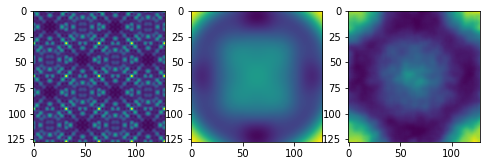

1
Log loss is:  361.1145212538624


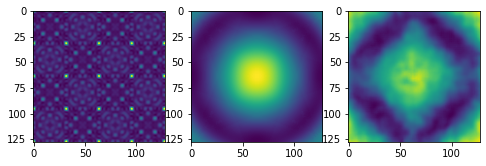

2
Log loss is:  102.1912999765336


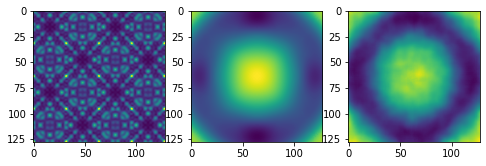

3
Log loss is:  61.369159764296136


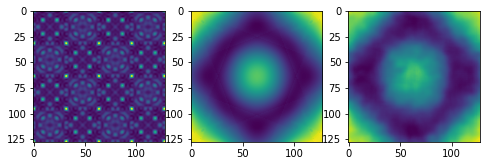

4
Log loss is:  25.034380025454883


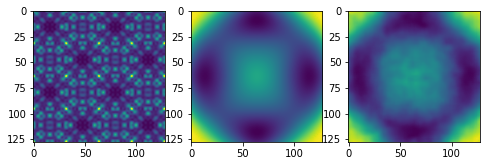

5
Log loss is:  149.13748496451984


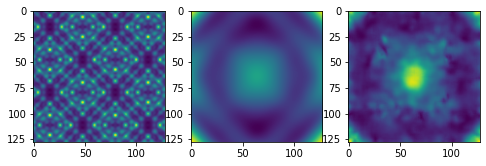

6
Log loss is:  94.4717826839548


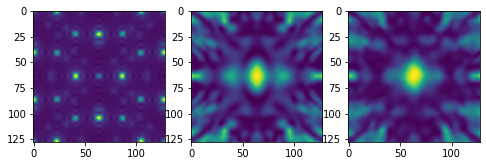

7
Log loss is:  80.8208222501148


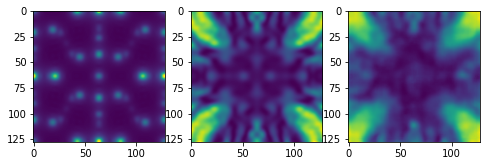

8
Log loss is:  66.1399716087266


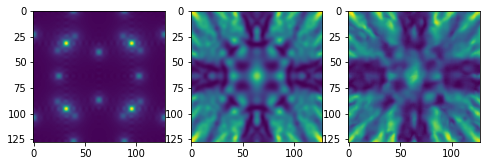

9
Log loss is:  89.65464166979355


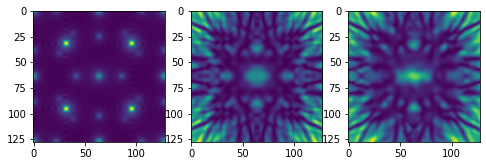

10
Log loss is:  269.9611608564764


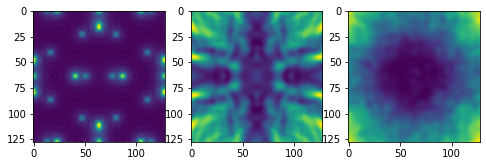

11
Log loss is:  272.1043780135104


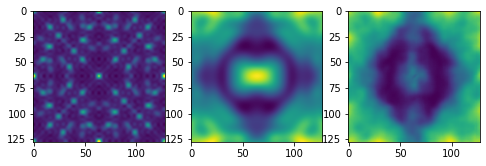

12
Log loss is:  85.80917478849676


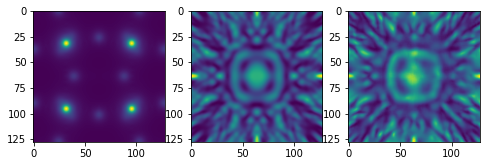

13
Log loss is:  58.392671882789


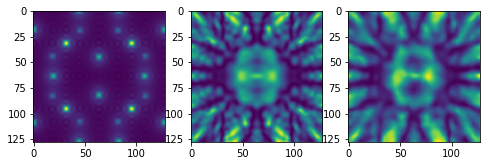

14
Log loss is:  60.943815424096144


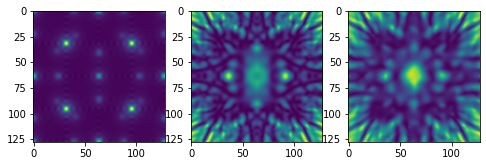

15
Log loss is:  48.624662985127266


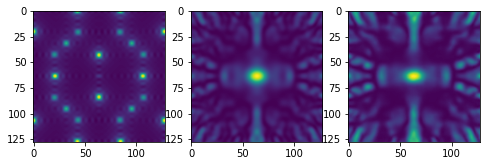

16
Log loss is:  130.23024906395582


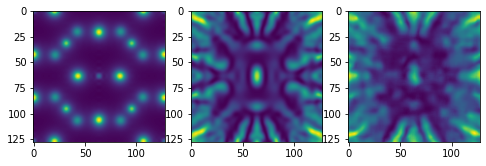

17
Log loss is:  49.34201777433874


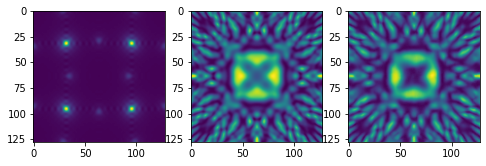

18
Log loss is:  10.46577841997716


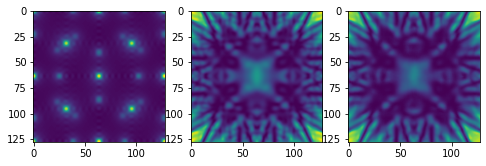

19
Log loss is:  13.217130872934877


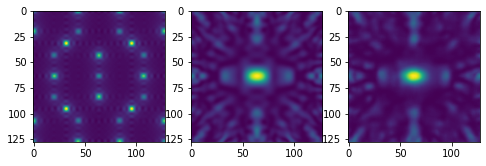

20
Log loss is:  158.4269778170813


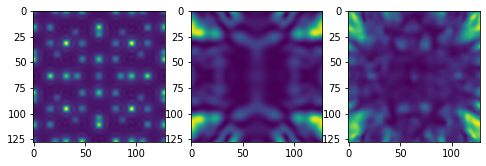

21
Log loss is:  11.880222348441295


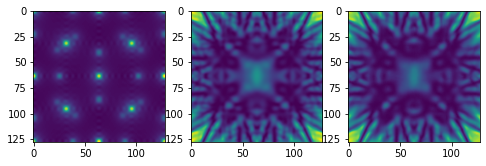

22
Log loss is:  148.84978047653567


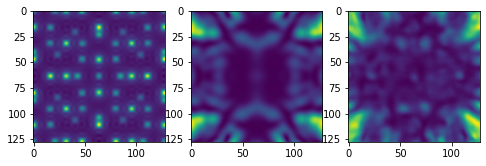

23
Log loss is:  145.33668752953977


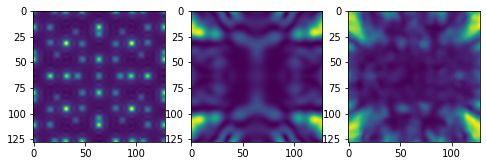

24
Log loss is:  8.087786073010443


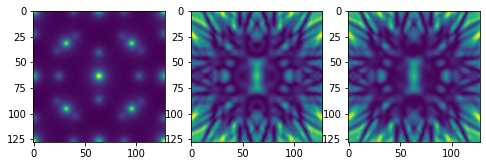

25
Log loss is:  15.855053058324348


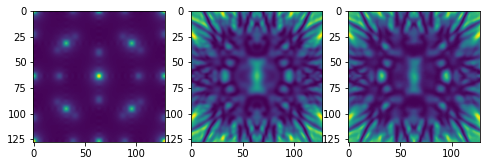

26
Log loss is:  69.37229588284785


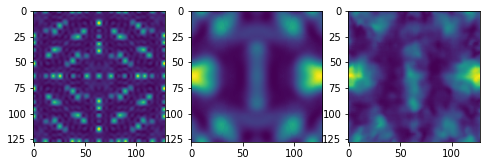

27
Log loss is:  24.872481395942696


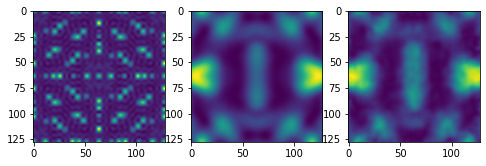

28
Log loss is:  932.1318768437472


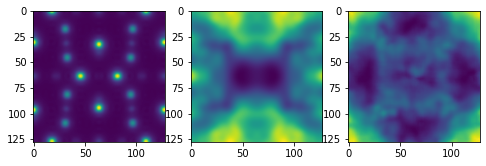

29
Log loss is:  54.71540557332944


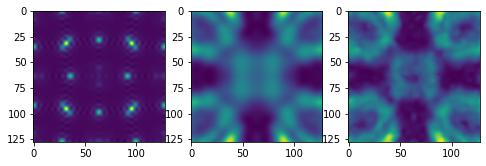

30
Log loss is:  30.23486801069398


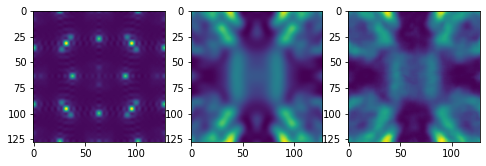

31
Log loss is:  131.2182334457543


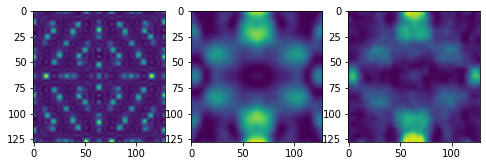

32
Log loss is:  7.476706510808312


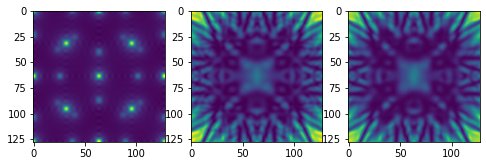

33
Log loss is:  13.276795576170224


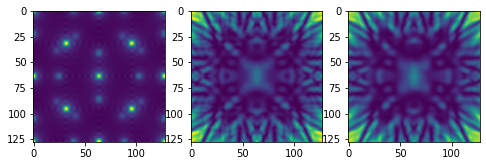

34
Log loss is:  30.74334923250633


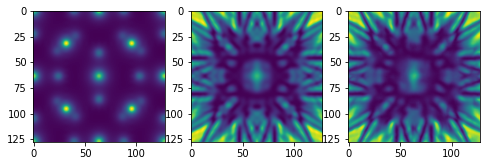

35
Log loss is:  11.94170584124917


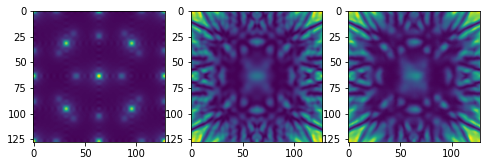

36
Log loss is:  5.8282252668356245


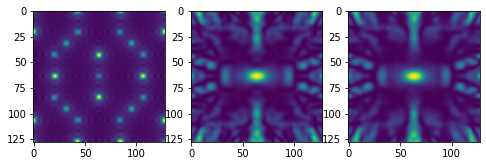

37
Log loss is:  338.26761105501436


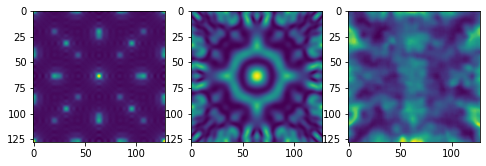

38
Log loss is:  47.33595365584434


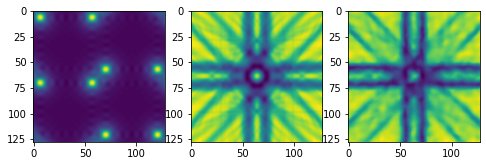

39
Log loss is:  445.79638485797204


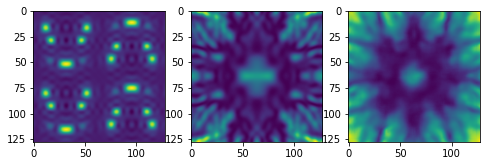

40
Log loss is:  48.76329914490964


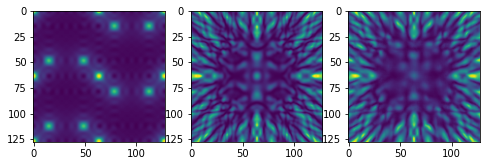

41
Log loss is:  105.74931987564652


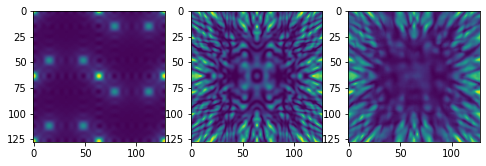

42
Log loss is:  148.30208035509807


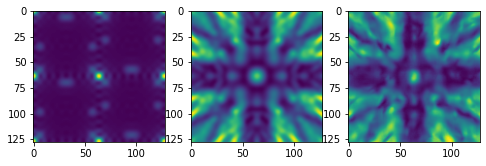

43
Log loss is:  15.975812991609303


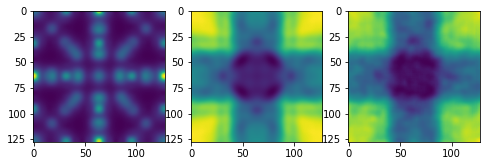

44
Log loss is:  16.196709188876522


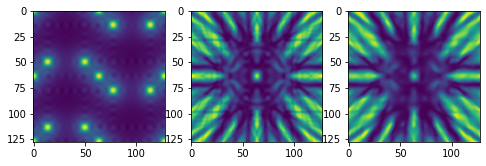

45
Log loss is:  19.88551334634678


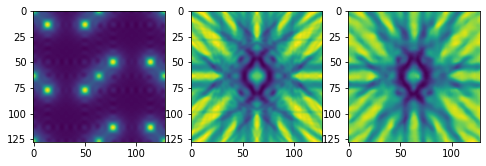

46
Log loss is:  179.32240940141932


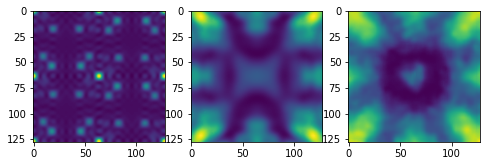

47
Log loss is:  78.6249725435754


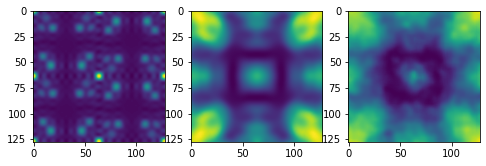

48
Log loss is:  140.95566160339135


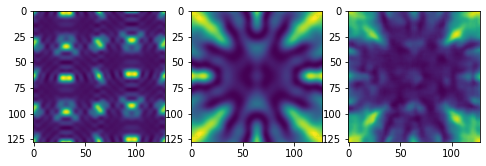

49
Log loss is:  16.026379932665144


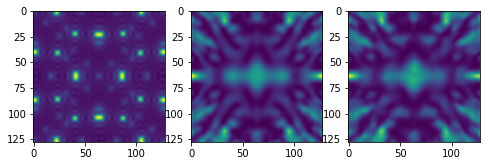

50
Log loss is:  23.345279264447882


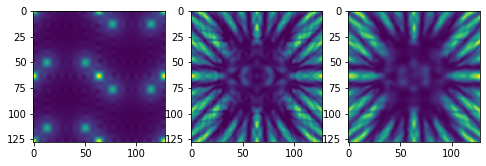

51
Log loss is:  77.86597130066097


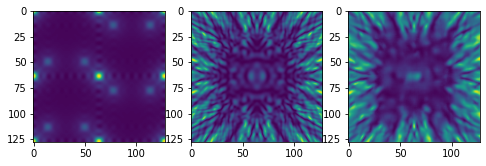

52
Log loss is:  80.37122718824811


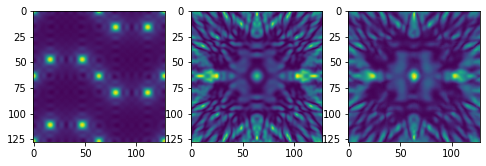

53
Log loss is:  80.88884211644603


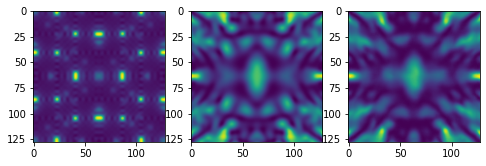

54
Log loss is:  21.018381773737474


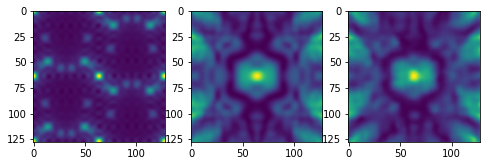

55
Log loss is:  277.7947295478665


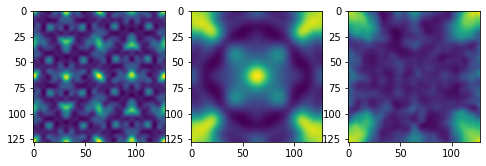

56
Log loss is:  84.36629619937557


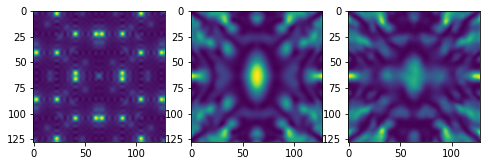

57
Log loss is:  65.33566417425304


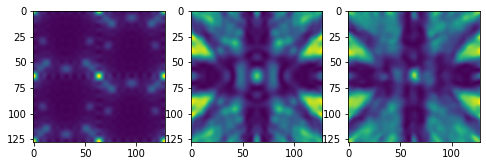

58
Log loss is:  73.82182622498007


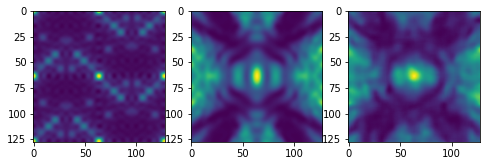

59
Log loss is:  17.24243101438828


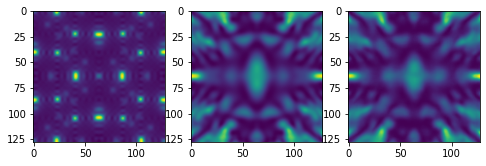

60
Log loss is:  19.672527175976647


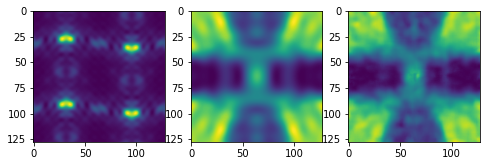

61
Log loss is:  103.32554908883817


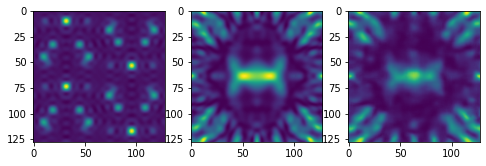

62
Log loss is:  47.692555211777325


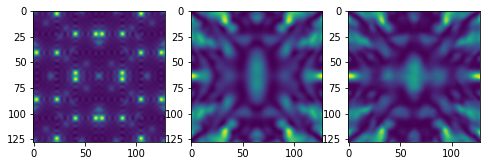

63
Log loss is:  931.8318592893103


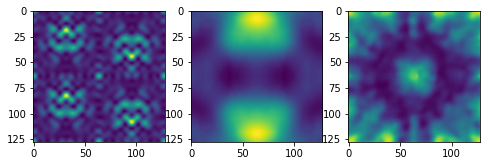

64
Log loss is:  159.5902283610314


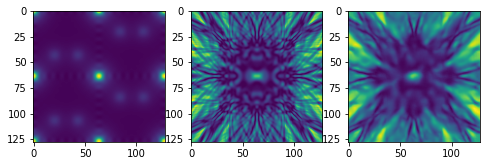

65
Log loss is:  22.03722000032037


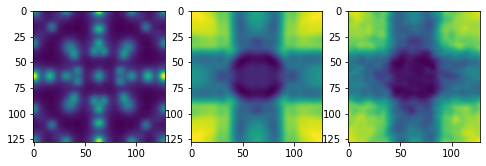

66
Log loss is:  401.1264829969297


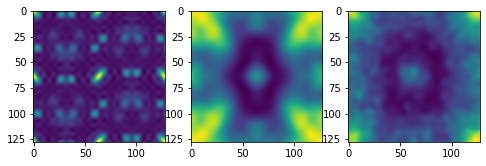

67
Log loss is:  160.08440644782013


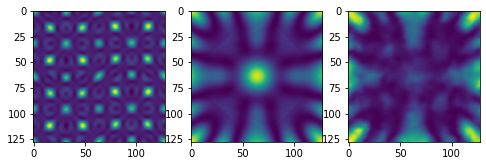

68
Log loss is:  286.5230434928768


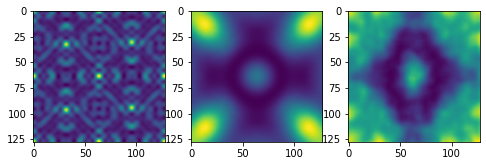

69
Log loss is:  104.45845857306966


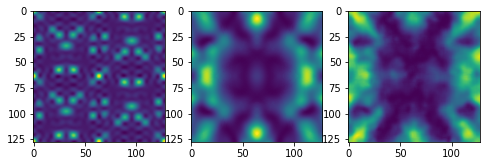

70
Log loss is:  499.1411093852137


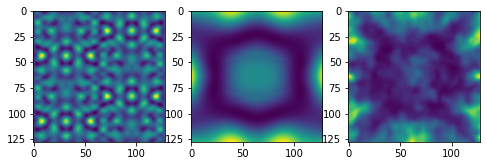

71
Log loss is:  7.342795331756443


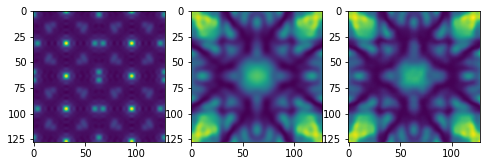

72
Log loss is:  260.04853067073185


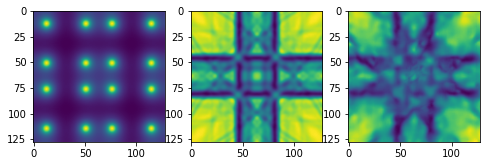

73
Log loss is:  10.51616979876555


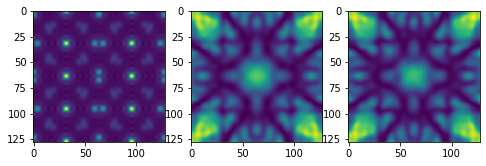

74
Log loss is:  78.66321825916354


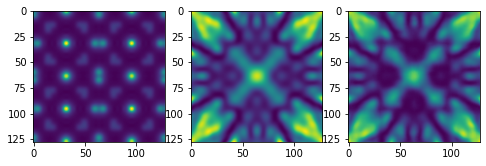

75
Log loss is:  89.87224100928664


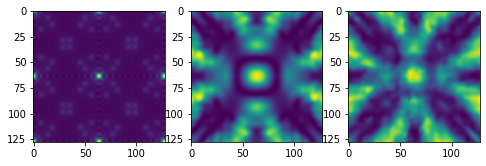

76
Log loss is:  51.02933149614


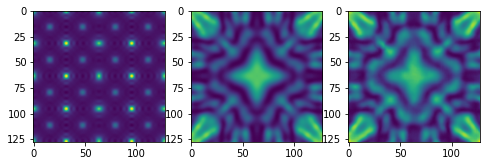

77
Log loss is:  14.004670483720446


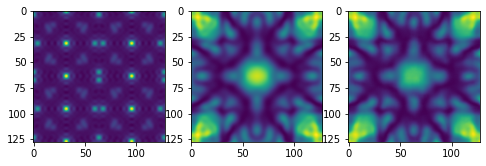

78
Log loss is:  6.218371561439758


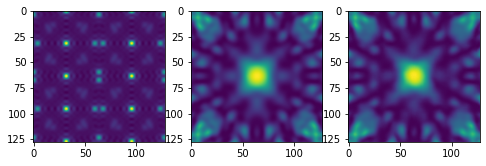

79
Log loss is:  158.58460904159293


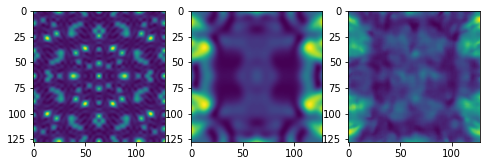

80
Log loss is:  596.4403648539216


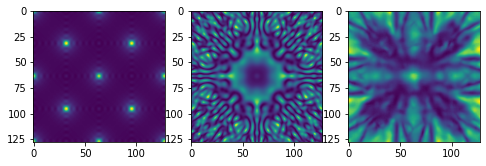

81
Log loss is:  10.37411272537966


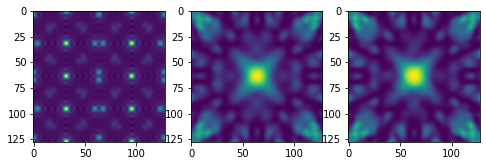

82
Log loss is:  82.88621484772987


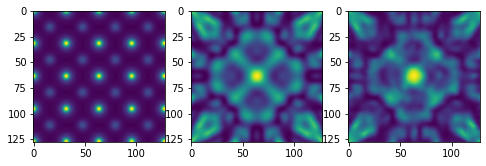

83
Log loss is:  153.2846512652298


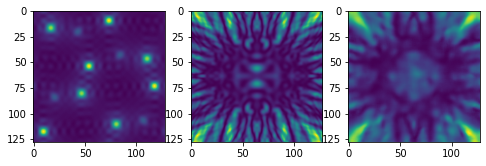

84
Log loss is:  37.40828434689986


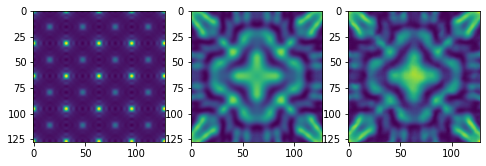

85
Log loss is:  11.742666799318657


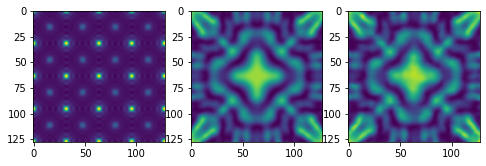

86
Log loss is:  164.539515210168


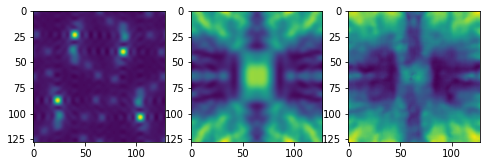

87
Log loss is:  161.5988217289653


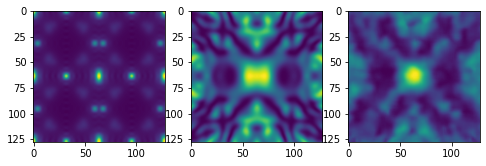

88
Log loss is:  43.214226337612054


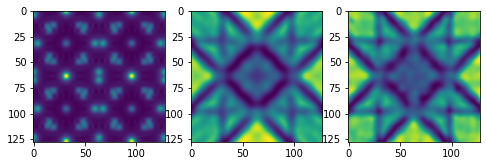

89
Log loss is:  32.95564820204166


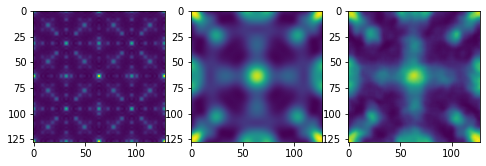

90
Log loss is:  574.1010486865298


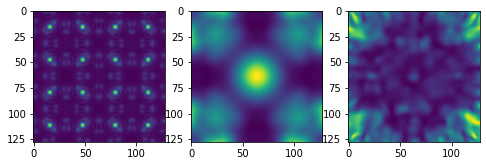

91
Log loss is:  159.06974967884565


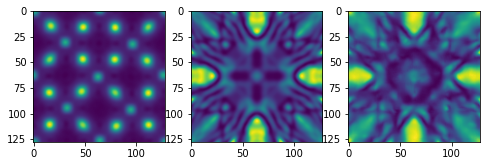

92
Log loss is:  158.18090339252214


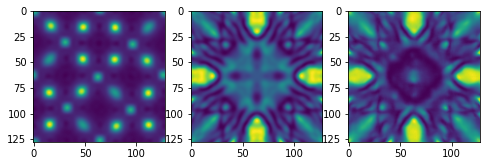

93
Log loss is:  43.36096852677181


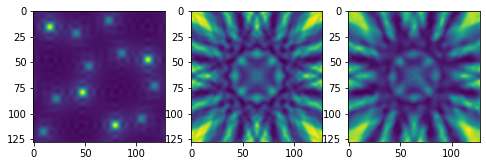

94
Log loss is:  33.09478794261357


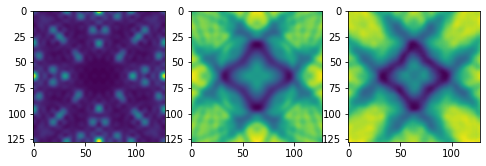

95
Log loss is:  141.65995901127553


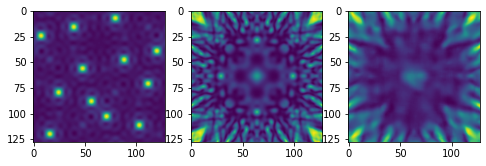

96
Log loss is:  102.04073322845788


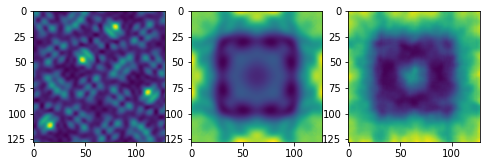

97
Log loss is:  20.466320420617805


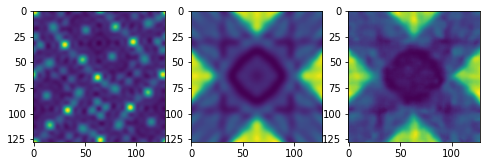

98
Log loss is:  431.86727458146385


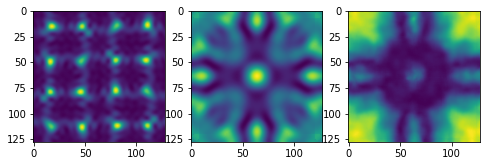

99
Log loss is:  28.241926842335346


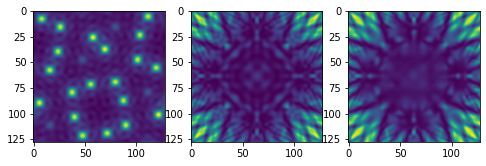

100
Log loss is:  24.5704976448429


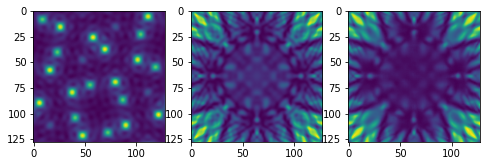

101
Log loss is:  30.433762069284718


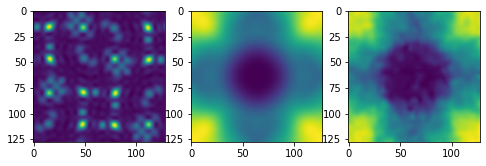

102
Log loss is:  20.11108690098328


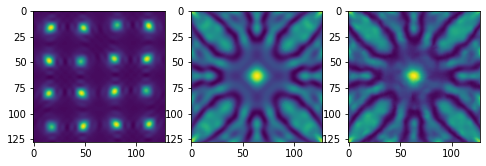

103
Log loss is:  84.46837819644259


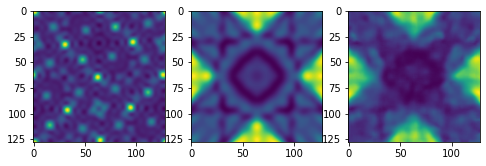

104
Log loss is:  13.714436732511604


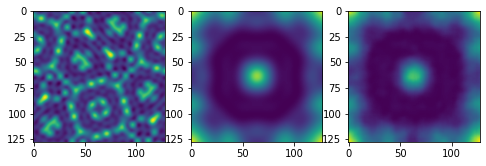

105
Log loss is:  10.034768046403542


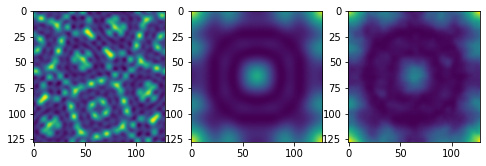

106
Log loss is:  118.71436418726103


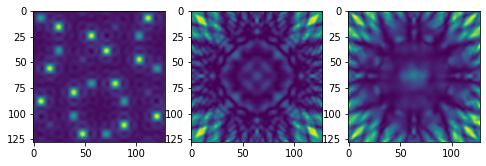

107
Log loss is:  158.35143730426387


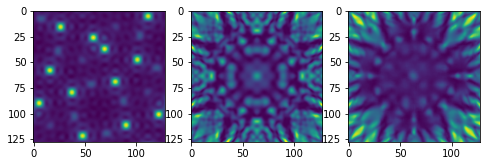

108
Log loss is:  170.00471425341456


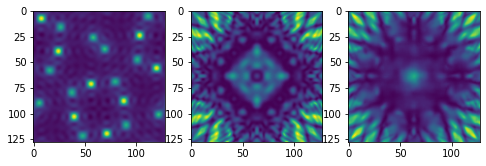

109
Log loss is:  89.3458857713682


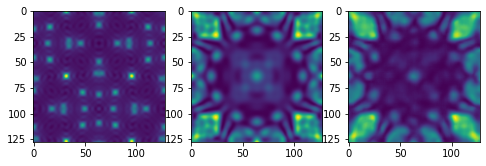

110
Log loss is:  470.2064505745594


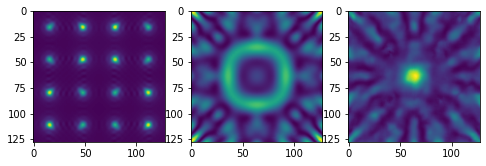

111
Log loss is:  131.09513083600038


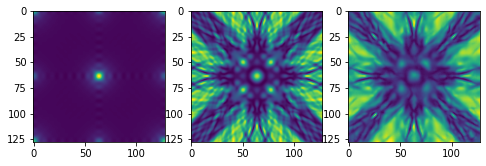

112
Log loss is:  374.8902152367062


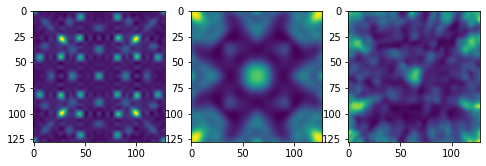

113
Log loss is:  584.836598650336


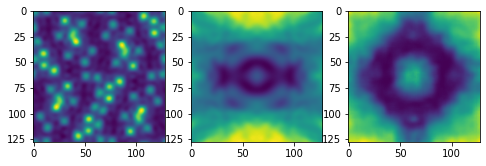

114
Log loss is:  159.31294826779794


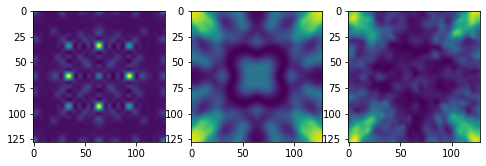

115
Log loss is:  88.95548384976796


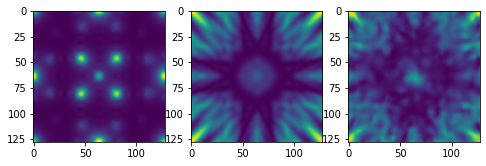

116
Log loss is:  74.87107936830463


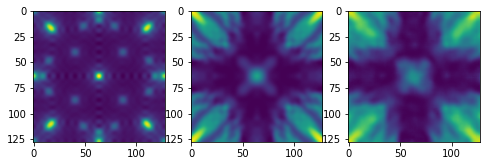

117
Log loss is:  64.04950335278217


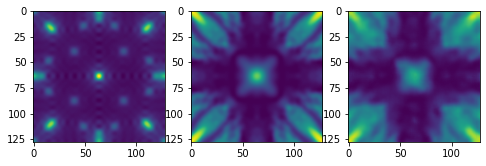

118
Log loss is:  520.6327504286305


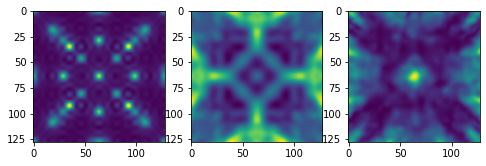

119
Log loss is:  60.736246669468336


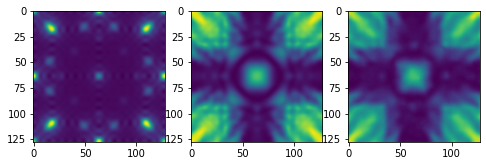

120
Log loss is:  51.44471919809892


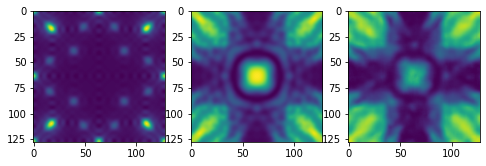

121
Log loss is:  26.88528747728227


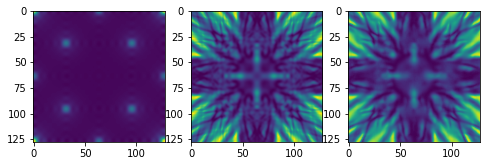

122
Log loss is:  32.92960005908048


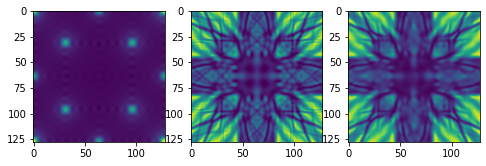

123
Log loss is:  28.453929187085976


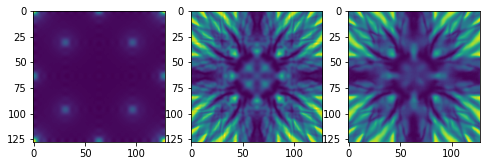

124
Log loss is:  65.93335278191755


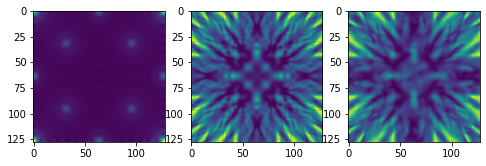

125
Log loss is:  35.09546561439744


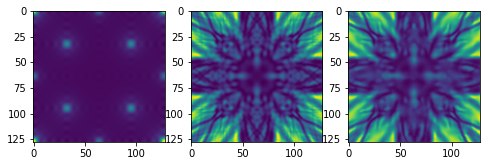

126
Log loss is:  61.55258407933634


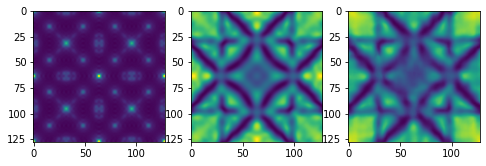

127
Log loss is:  247.73240631244872


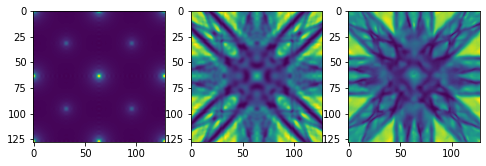

128
Log loss is:  112.25846438399815


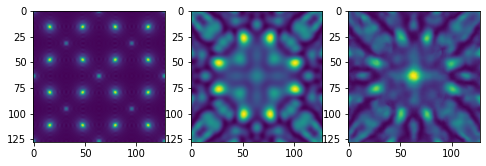

129
Log loss is:  391.99850625288366


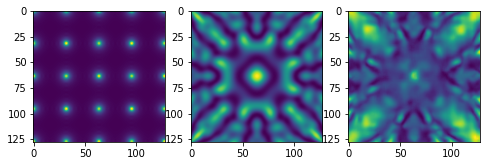

130
Log loss is:  168.22451423629917


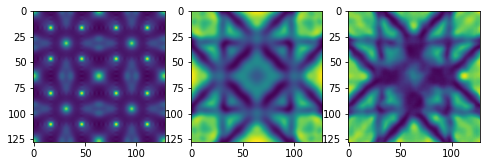

131
Log loss is:  293.30737428840627


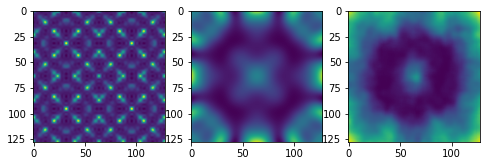

132
Log loss is:  609.7994294663595


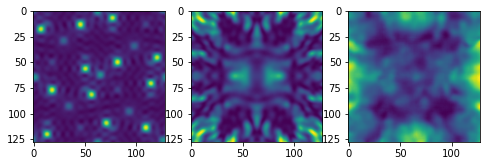

133
Log loss is:  64.2812473864768


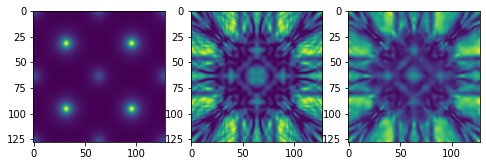

134
Log loss is:  436.2938708515618


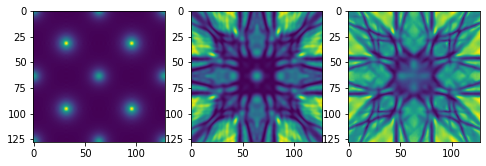

135
Log loss is:  25.561897918677026


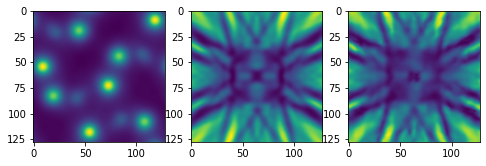

136
Log loss is:  50.45138865620812


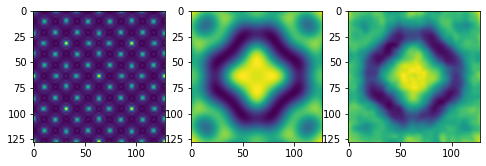

137
Log loss is:  89.72352625762645


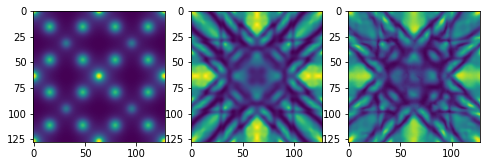

138
Log loss is:  43.14480643229114


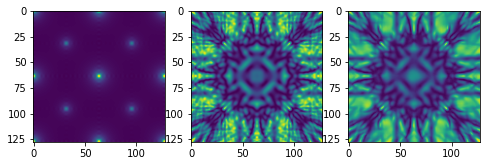

139
Log loss is:  34.99867600153979


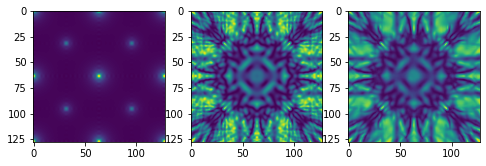

140
Log loss is:  47.16030303454166


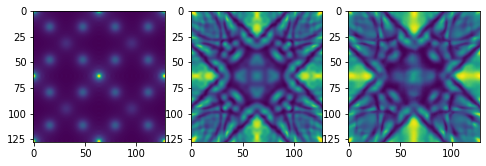

141
Log loss is:  26.434800312033946


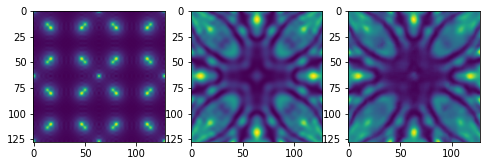

142
Log loss is:  46.747878631301035


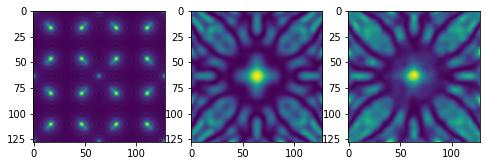

143
Log loss is:  47.35640727399206


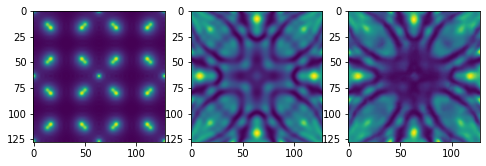

144
Log loss is:  178.72183344833707


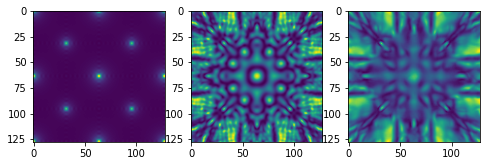

145
Log loss is:  435.8269986125919


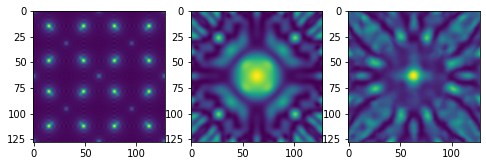

146
Log loss is:  377.3876329282319


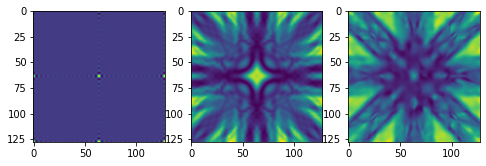

147
Log loss is:  149.30391563300893


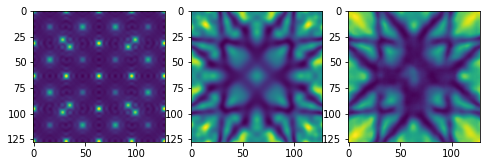

148
Log loss is:  53.166445034764614


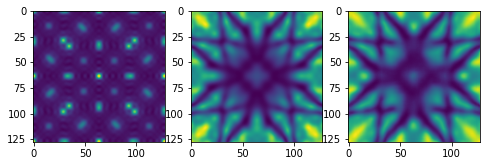

149
Log loss is:  151.40214919909977


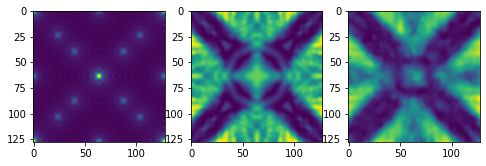

150
Log loss is:  40.636494512072396


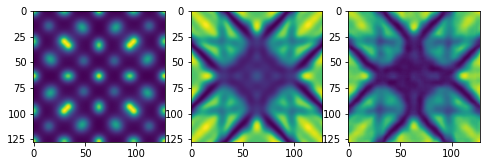

151
Log loss is:  19.585313325832733


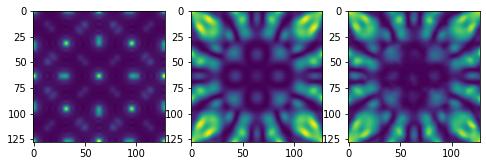

152
Log loss is:  65.05264955235624


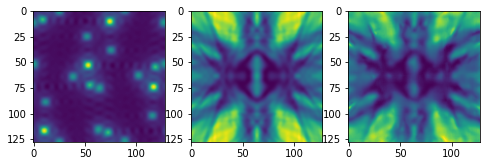

153
Log loss is:  233.65526698549868


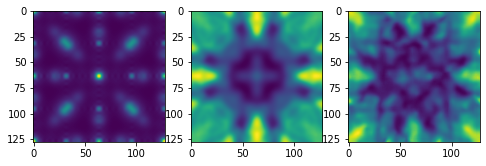

154
Log loss is:  124.60289785807169


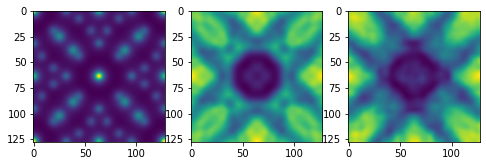

155
Log loss is:  142.33389358079407


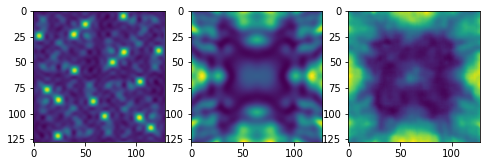

156
Log loss is:  426.6242594627229


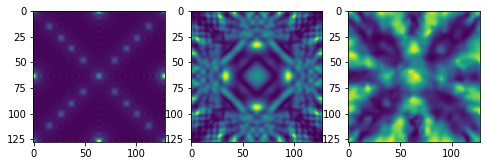

157
Log loss is:  11.350988066129284


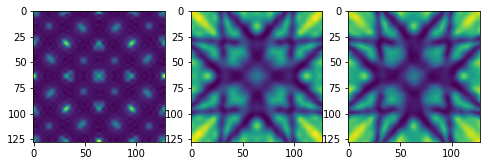

158
Log loss is:  9.499184340845368


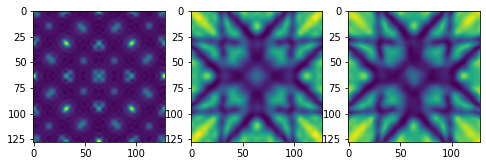

159
Log loss is:  42.63735441630015


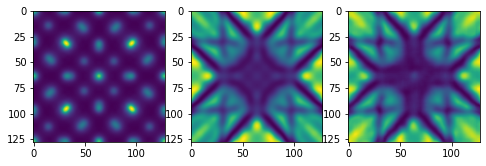

160
Log loss is:  164.17779491439552


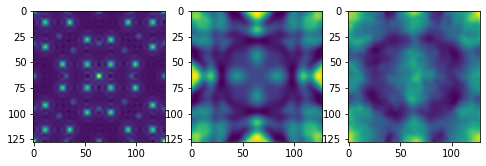

161
Log loss is:  13.245186007029437


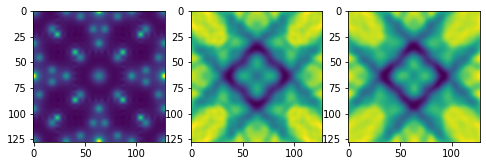

162
Log loss is:  315.0487817385324


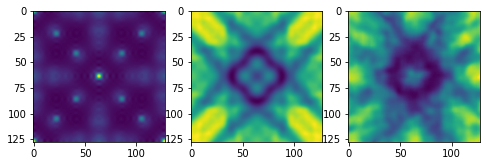

163
Log loss is:  12.47753030877435


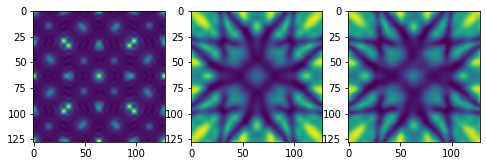

164
Log loss is:  35.57493321764425


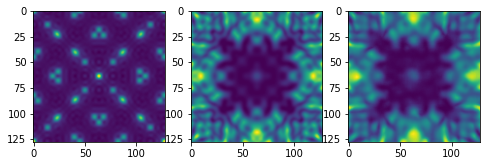

165
Log loss is:  12.400234162713419


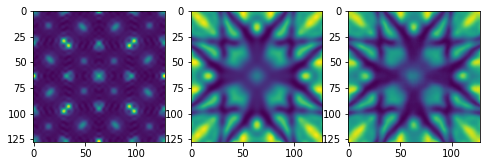

166
Log loss is:  17.03228407115327


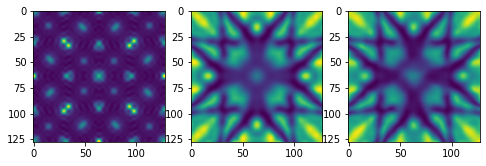

167
Log loss is:  14.908878258253386


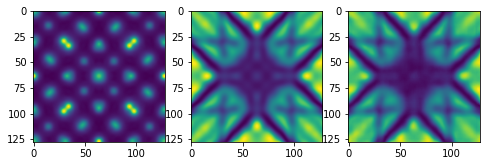

168
Log loss is:  420.9442418788391


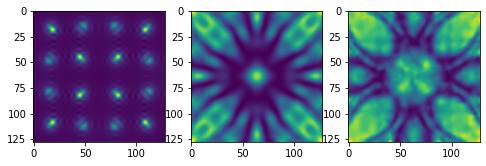

169
Log loss is:  526.7028612336726


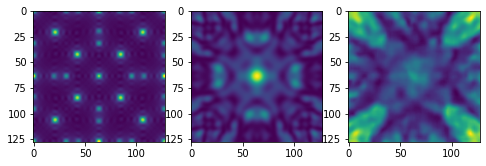

170
Log loss is:  8.63257724658088


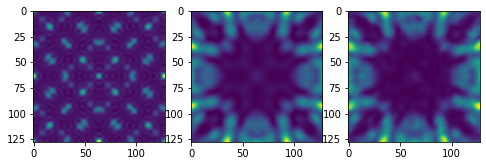

171
Log loss is:  13.960443633091055


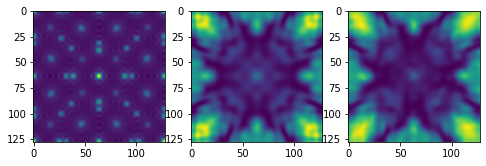

172
Log loss is:  90.89901170784748


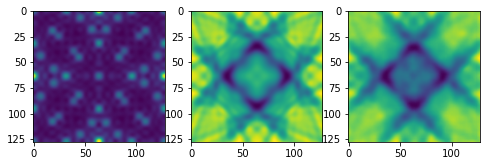

173
Log loss is:  178.49957943093395


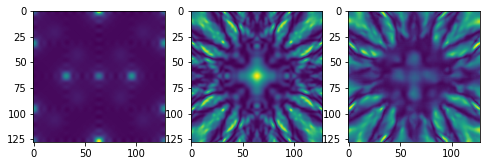

174
Log loss is:  35.307694821515724


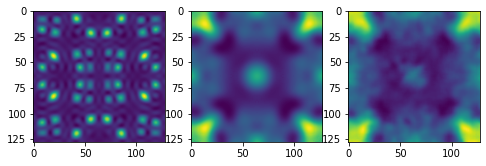

175
Log loss is:  11.705160056856094


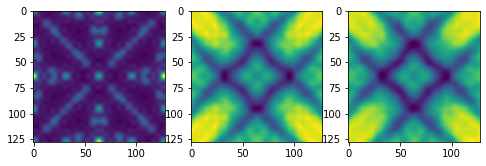

176
Log loss is:  82.72518150240249


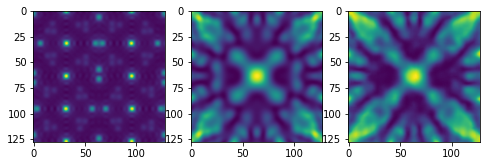

177
Log loss is:  11.045009566247856


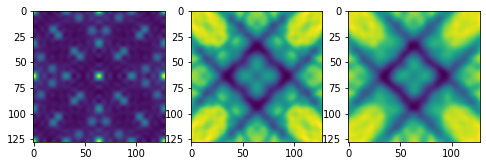

178
Log loss is:  7.828227888835645


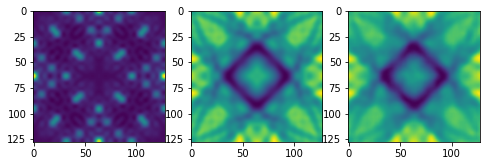

179
Log loss is:  22.861765625116764


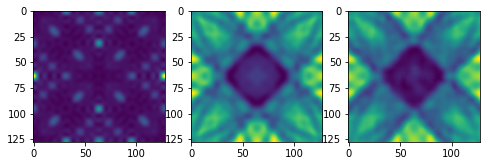

180
Log loss is:  22.49756759360534


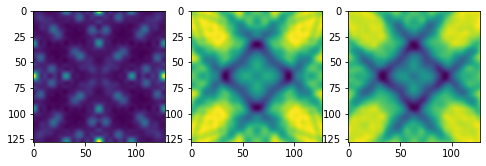

181
Log loss is:  26.883592523392178


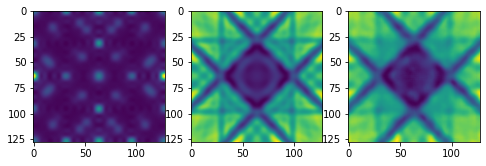

182
Log loss is:  20.67937633179849


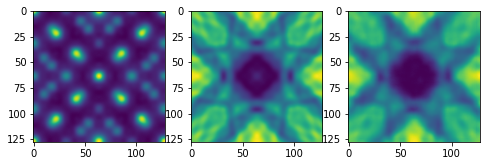

183
Log loss is:  9.475389013207979


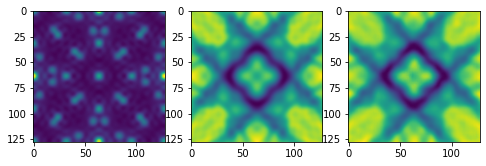

184
Log loss is:  68.84799845418014


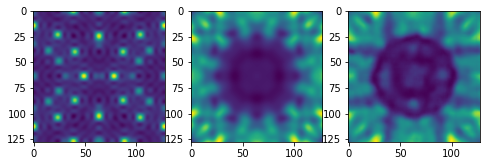

185
Log loss is:  150.56599174850584


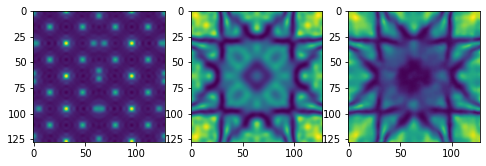

186
Log loss is:  124.27864741607547


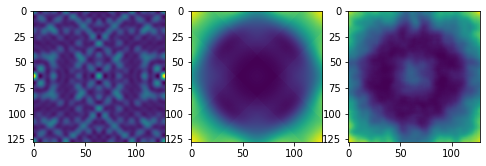

187
Log loss is:  3.2867668808447013


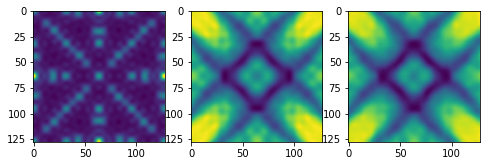

188
Log loss is:  10.017104471650176


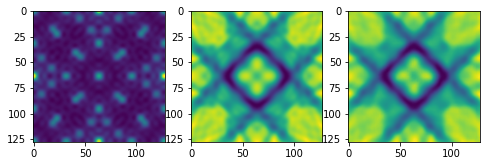

189
Log loss is:  12.89479973690066


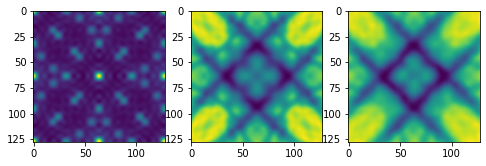

190
Log loss is:  20.335215177767406


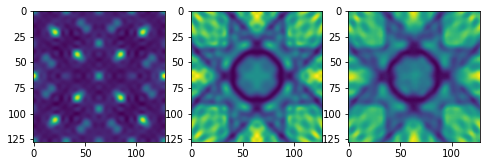

191
Log loss is:  4.451124944001018


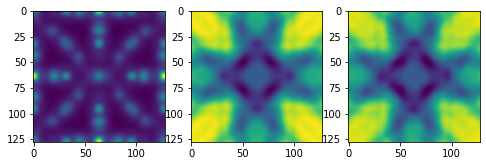

192
Log loss is:  80.59201355965942


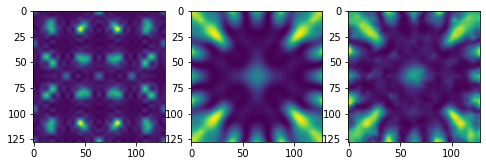

193
Log loss is:  328.7198263067095


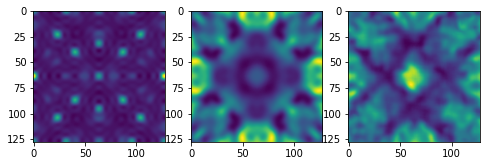

194
Log loss is:  7.604538343067483


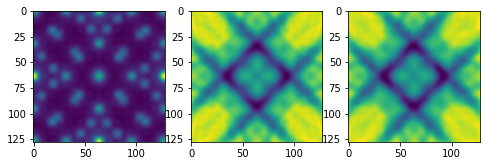

195
Log loss is:  6.115564073876587


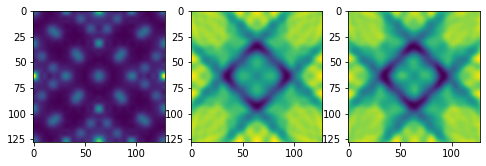

196
Log loss is:  32.373230444174354


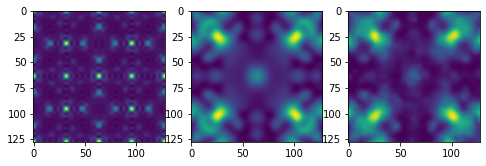

197
Log loss is:  11.189516605197964


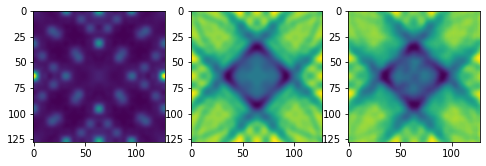

198
Log loss is:  21.79615378526352


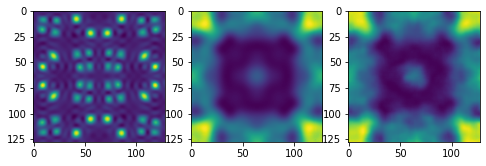

199
Log loss is:  33.110378034613426


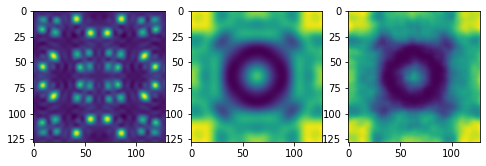

200
Log loss is:  49.28685966940906


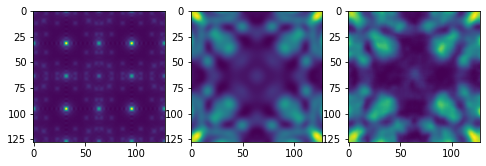

201
Log loss is:  31.97623837051777


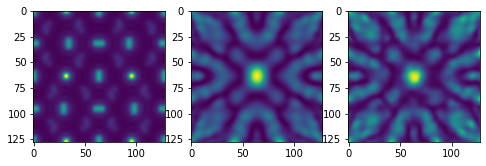

202
Log loss is:  24.40308979902742


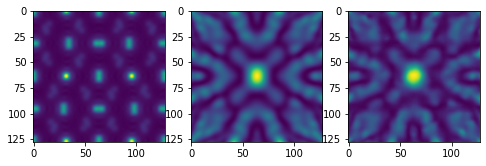

203
Log loss is:  891.213268046083


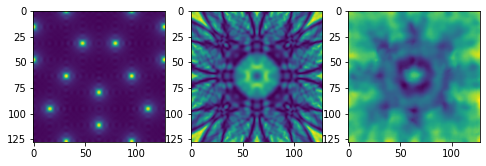

204
Log loss is:  36.07030557607895


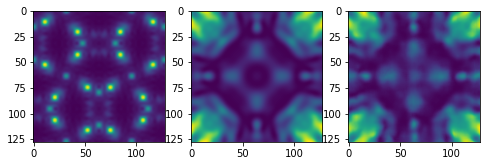

205
Log loss is:  152.13716411944793


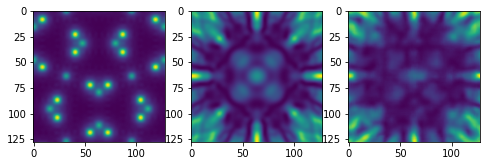

206
Log loss is:  234.92608401563356


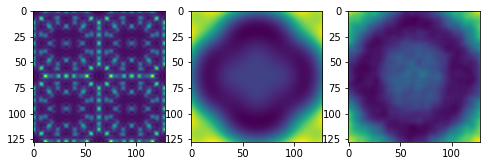

207
Log loss is:  222.8820170023518


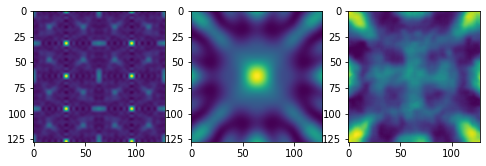

208
Log loss is:  45.71434657986118


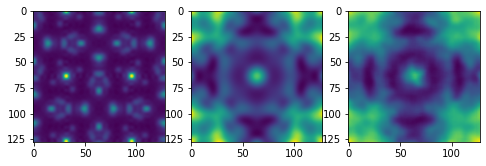

209
Log loss is:  13.508540511960206


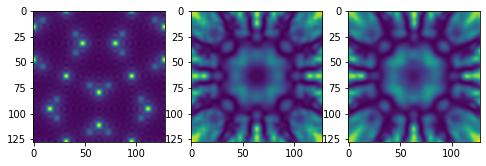

210
Log loss is:  203.32684740522276


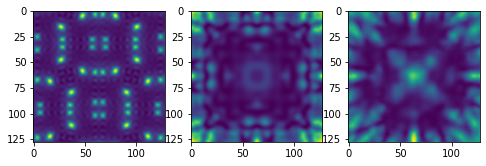

211
Log loss is:  235.42982554399165


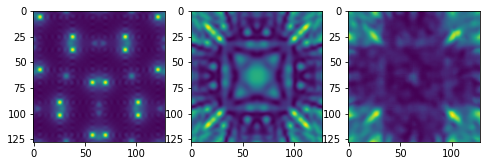

212
Log loss is:  40.43301832226848


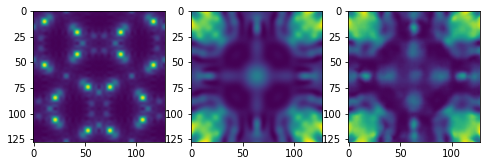

213
Log loss is:  193.31652152979674


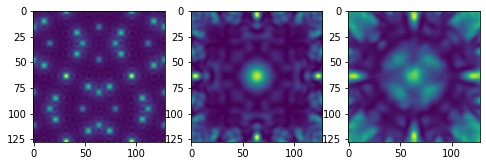

214
Log loss is:  301.2016130901499


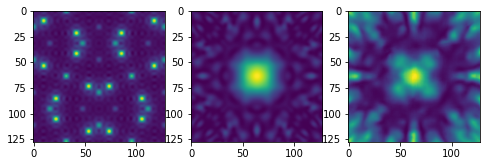

215
Log loss is:  846.1821610257637


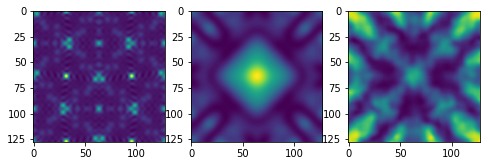

216
Log loss is:  91.46571355502246


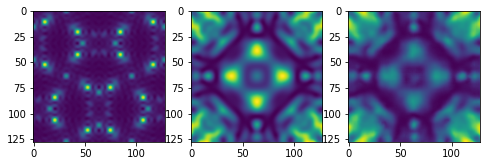

217
Log loss is:  26.61683367094876


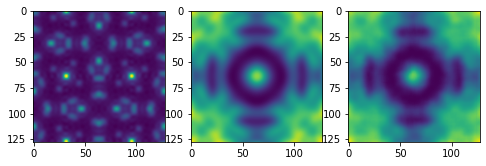

218
Log loss is:  196.5207749987718


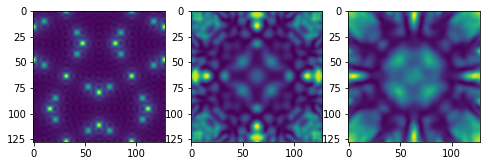

219
Log loss is:  8.423351226177516


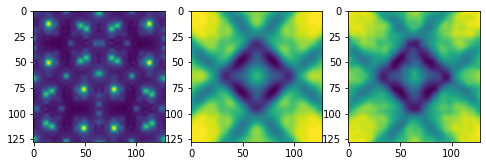

220
Log loss is:  143.57501480316134


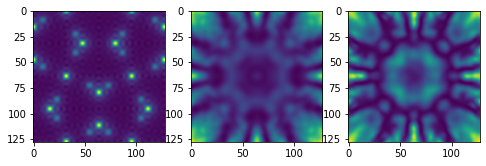

221
Log loss is:  165.45548654851925


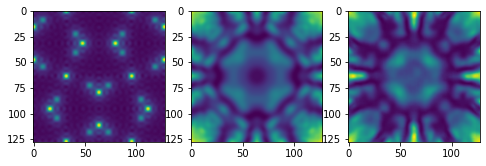

222
Log loss is:  321.7103063516653


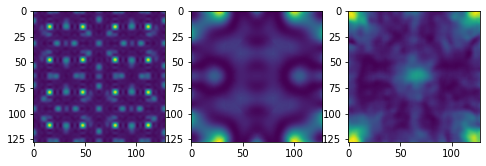

223
Log loss is:  155.17932858142538


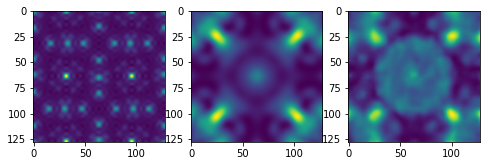

224
Log loss is:  24.88734214209464


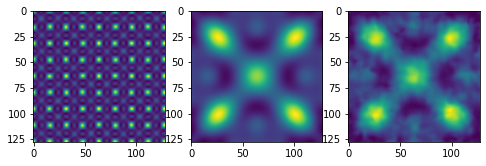

225
Log loss is:  23.544202685759693


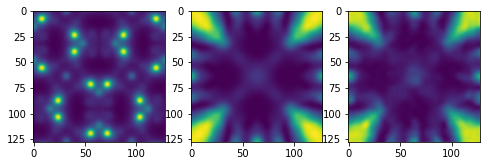

226
Log loss is:  366.9532204872734


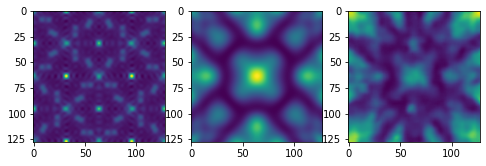

227
Log loss is:  217.2179789319453


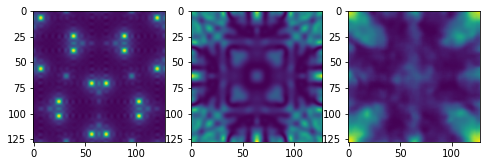

228
Log loss is:  13.178896644484993


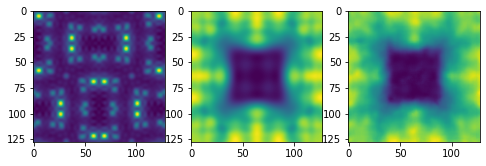

229
Log loss is:  10.99055930620971


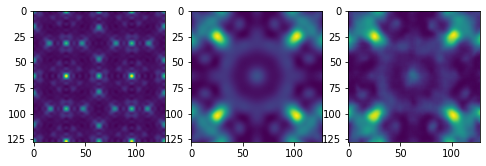

230
Log loss is:  134.65603856102823


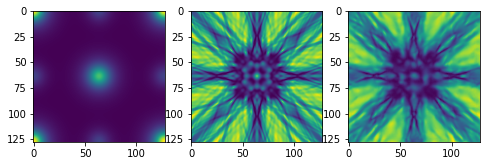

231
Log loss is:  36.62454178119938


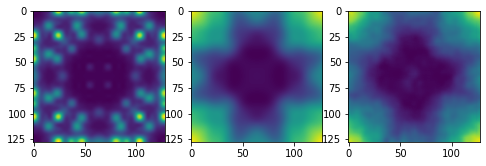

232
Log loss is:  22.18022360197482


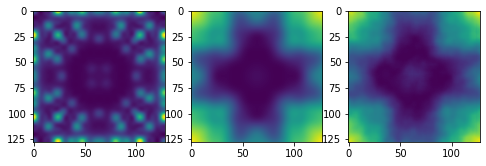

233
Log loss is:  53.20843785414672


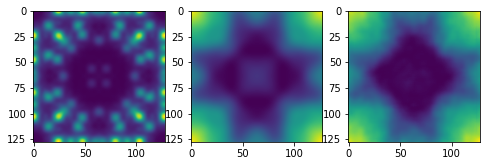

234
Log loss is:  79.04190659842318


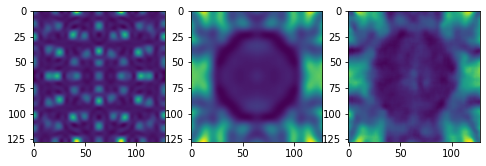

235
Log loss is:  213.0653268160191


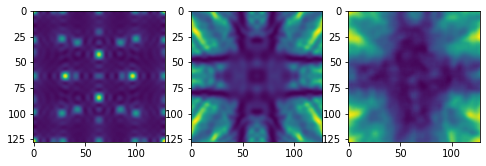

236
Log loss is:  25.53113320735237


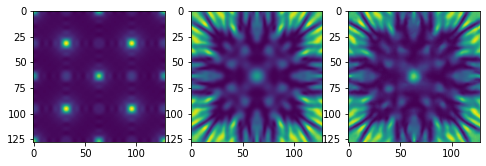

237
Log loss is:  27.146869868860193


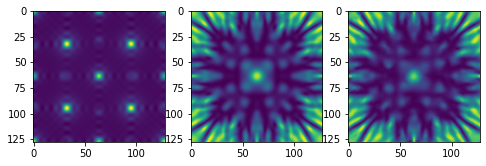

238
Log loss is:  693.8276503002672


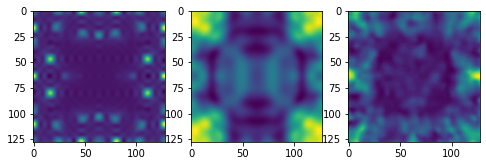

239
Log loss is:  5.202005553083546


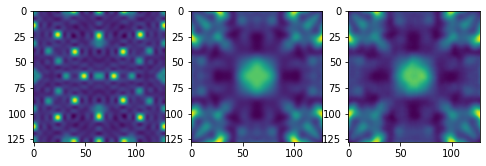

240
Log loss is:  4.602899854136869


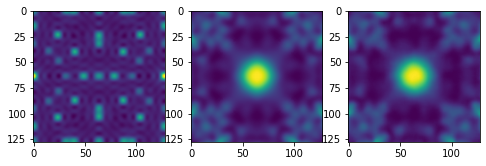

241
Log loss is:  147.89658402997733


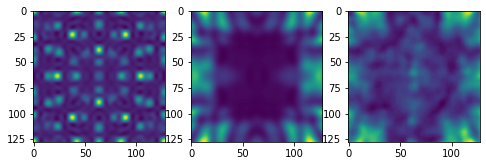

242
Log loss is:  551.4209844229971


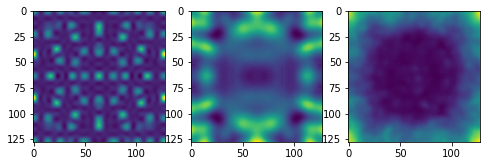

243
Log loss is:  9.073295738401782


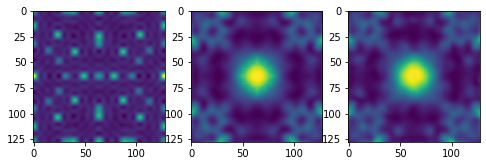

244
Log loss is:  16.387427954944926


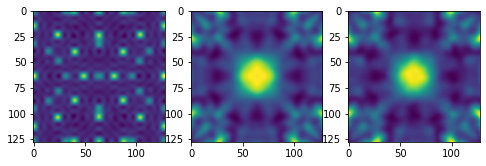

245
Log loss is:  280.68082143469996


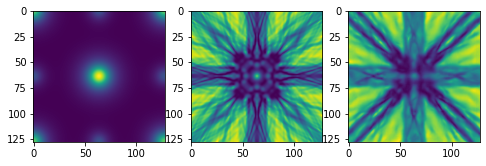

246
Log loss is:  14.524785871515709


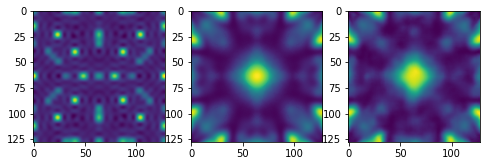

247
Log loss is:  22.50798006726409


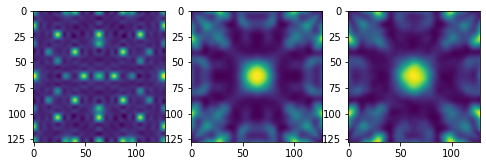

248
Log loss is:  16.102733678414754


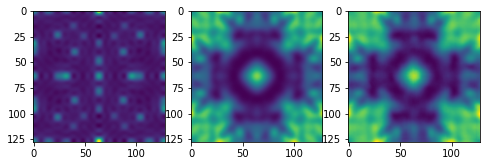

249
Log loss is:  113.88491654869847


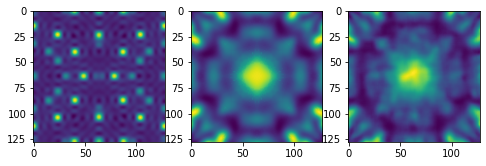

250
Log loss is:  4.082908876853636


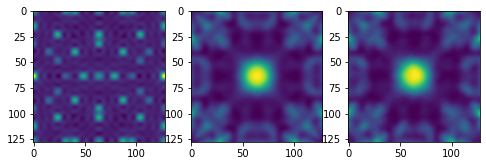

251
Log loss is:  11.99757206528839


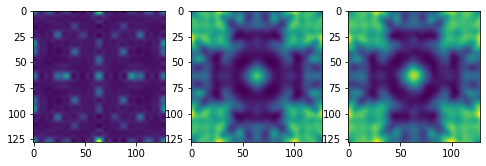

252
Log loss is:  17.401755725492023


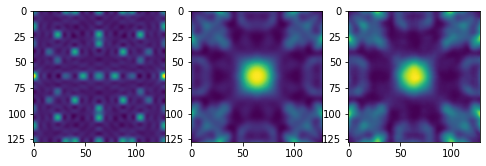

253
Log loss is:  11.867049901173383


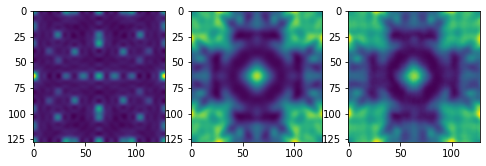

254
Log loss is:  49.696109323676595


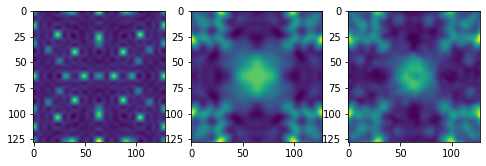

255
Log loss is:  18.672557866298124


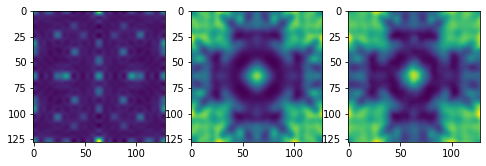

256
Log loss is:  15.606694302536717


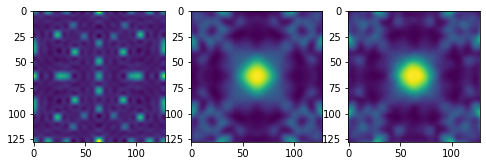

257
Log loss is:  106.5035080459384


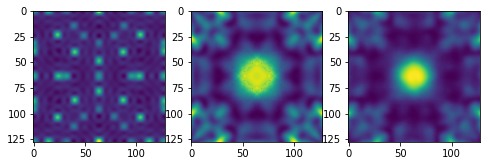

258
Log loss is:  284.23633966345056


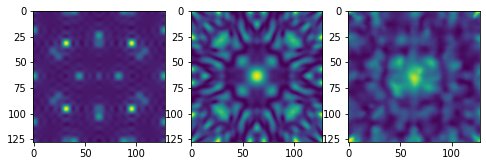

259
Log loss is:  5.726805658639032


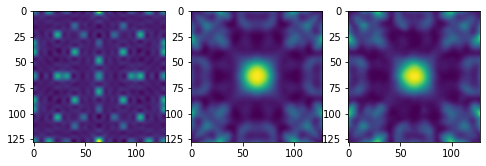

260
Log loss is:  270.88888280173956


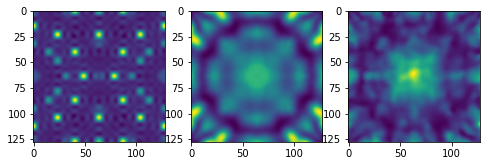

261
Log loss is:  264.1747952037848


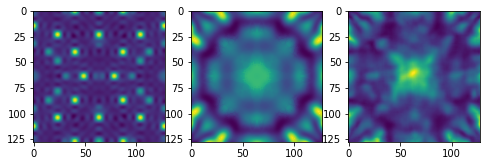

262
Log loss is:  190.49049792889505


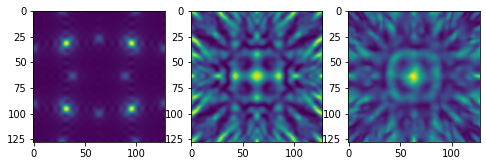

263
Log loss is:  46.85277980651264


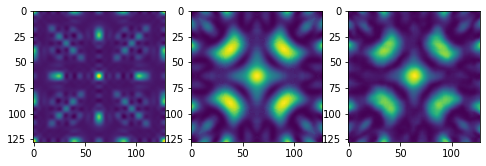

264
Log loss is:  12.164070933703737


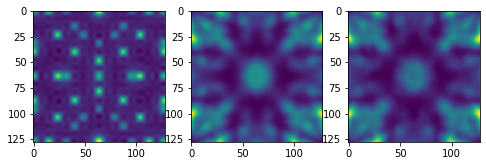

265
Log loss is:  22.87809403127059


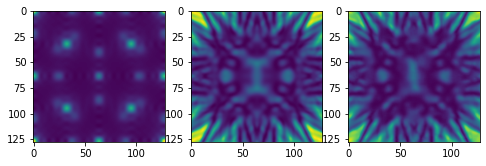

266
Log loss is:  85.4339377889835


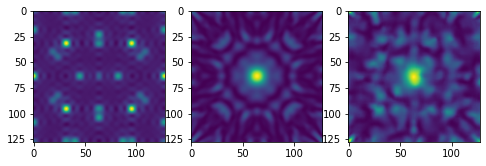

267
Log loss is:  20.38289332114336


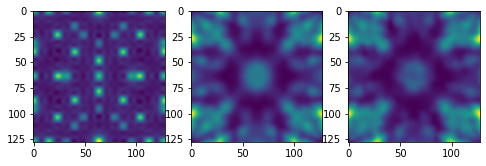

268
Log loss is:  33.32440561913178


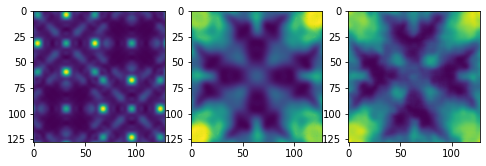

269
Log loss is:  19.90008866944394


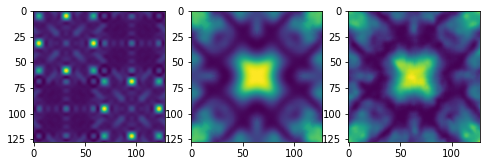

270
Log loss is:  101.20385143363337


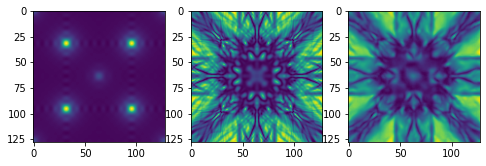

271
Log loss is:  56.77375855747807


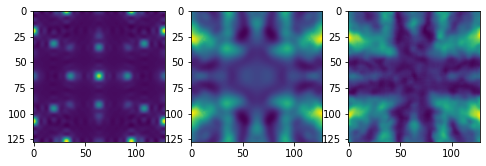

272
Log loss is:  53.259436082191925


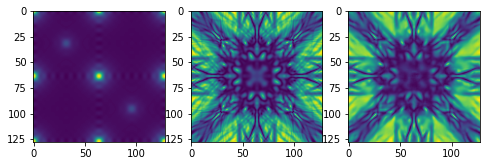

273
Log loss is:  120.22734534012989


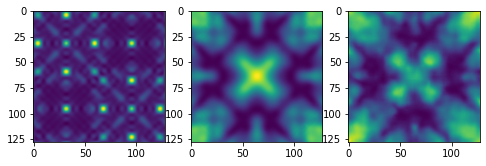

274
Log loss is:  376.57305535628626


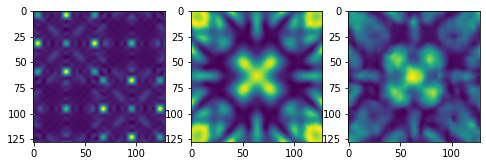

275
Log loss is:  603.6555623233257


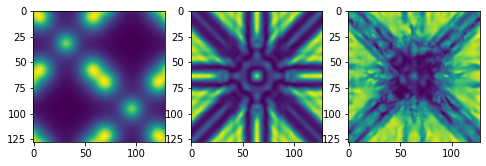

276
Log loss is:  241.7893029799981


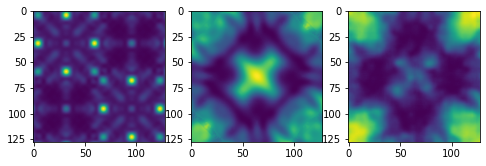

277
Log loss is:  15.4521901383932


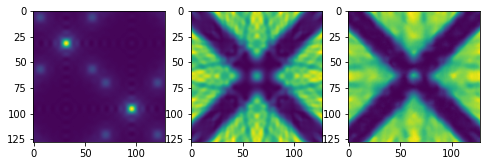

278
Log loss is:  87.46407880749953


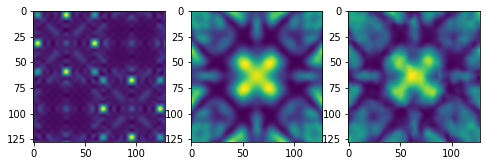

279
Log loss is:  558.879586051007


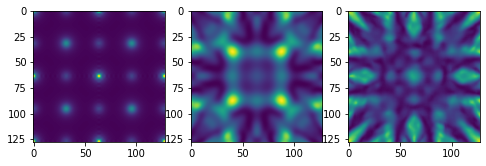

280
Log loss is:  14.754665030298014


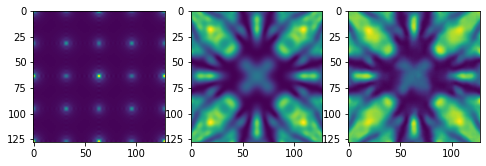

281
Log loss is:  262.29719080491367


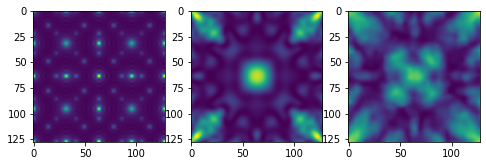

282
Log loss is:  164.23506933269036


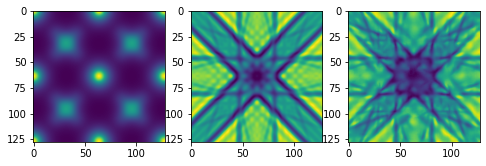

283
Log loss is:  29.858234073496032


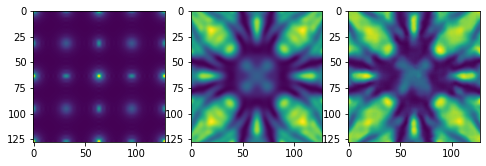

284
Log loss is:  388.054090199322


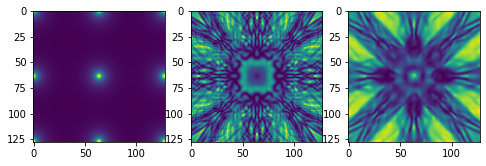

285
Log loss is:  49.70827155816428


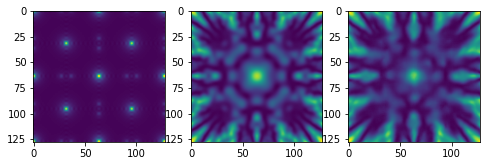

286
Log loss is:  107.0369363779862


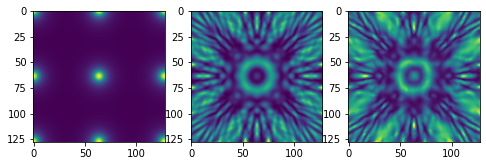

287
Log loss is:  172.87300315888822


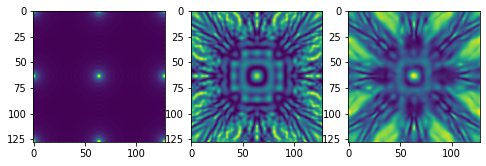

288
Log loss is:  12.250387795548155


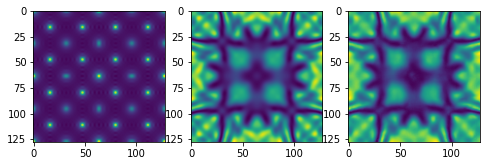

289
Log loss is:  172.42855843333356


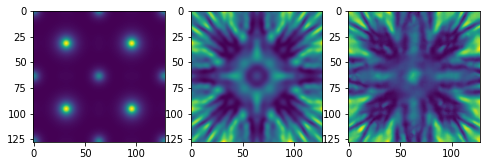

290
Log loss is:  506.3715340596941


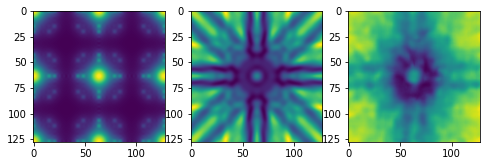

291
Log loss is:  380.85870191305895


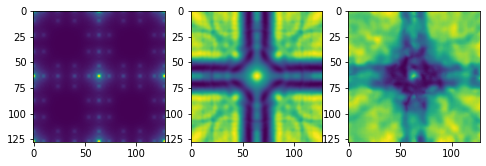

292
Log loss is:  83.33280730713781


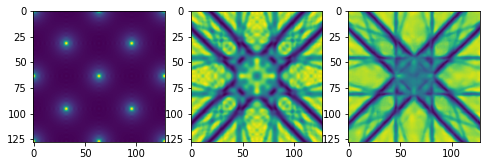

293
Log loss is:  51.71459895173534


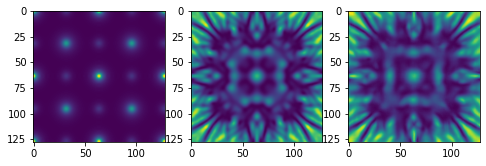

294
Log loss is:  52.81785604863262


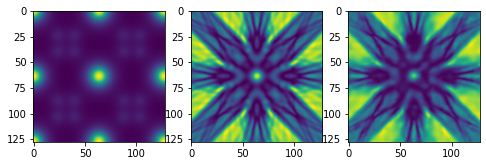

295
Log loss is:  24.692031171401887


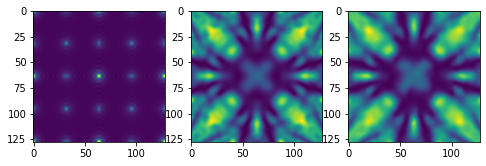

296
Log loss is:  112.98229972481586


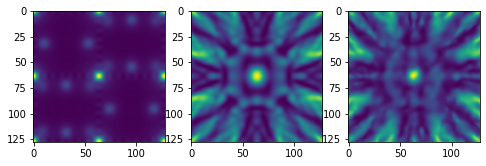

297
Log loss is:  149.77417730887962


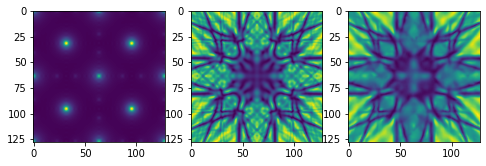

298
Log loss is:  30.3676141298818


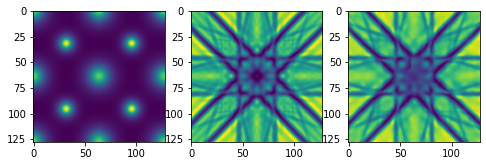

299
Log loss is:  91.0932424214173


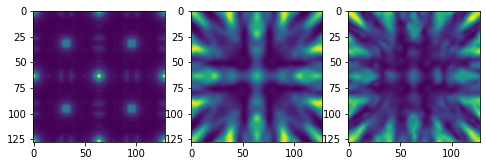

300
Log loss is:  31.101580401402785


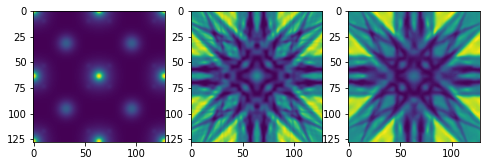

301
Log loss is:  98.3356075637674


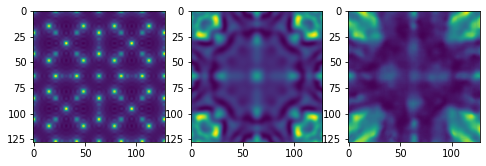

302
Log loss is:  63.889566532295206


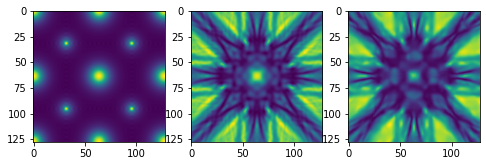

303
Log loss is:  147.00461318417146


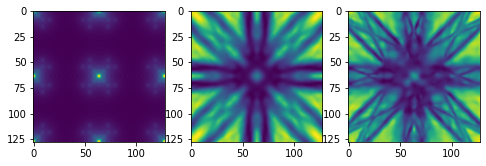

304
Log loss is:  40.99269906512641


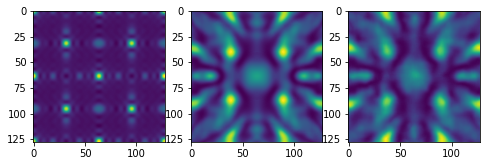

305
Log loss is:  30.765792346535953


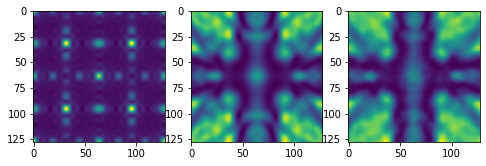

306
Log loss is:  142.9834975148683


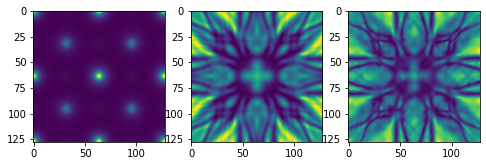

307
Log loss is:  47.97732345498858


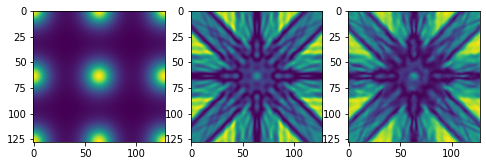

308
Log loss is:  103.93462156484242


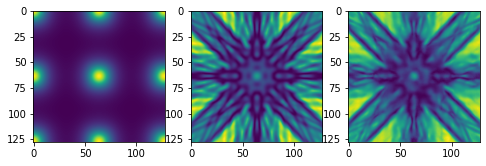

309
Log loss is:  258.309886129534


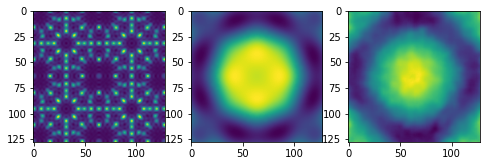

310
Log loss is:  515.0850923047705


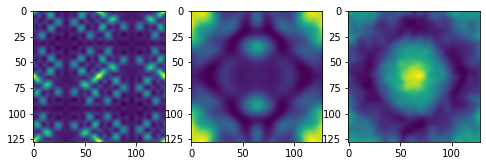

311
Log loss is:  63.52942895129701


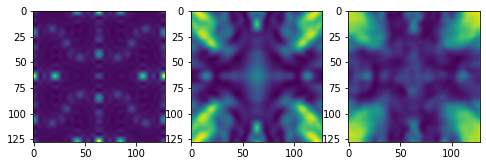

312
Log loss is:  18.70066384173455


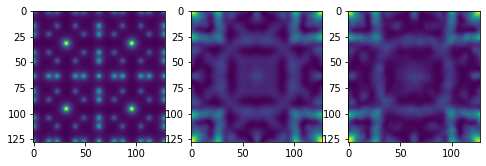

313
Log loss is:  23.738355065678274


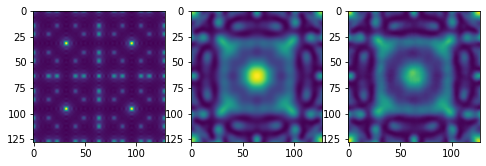

314
Log loss is:  16.625608317949244


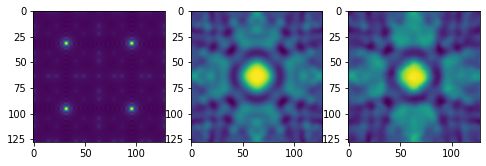

315
Log loss is:  40.48330684008293


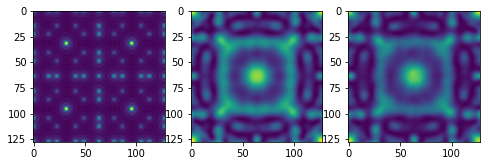

316
Log loss is:  605.8103342540574


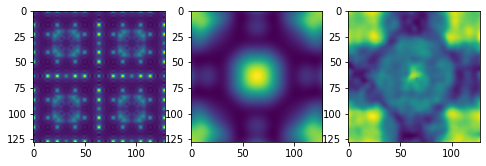

317
Log loss is:  406.5386589835011


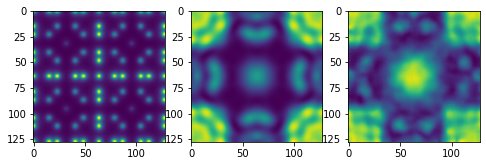

318
Log loss is:  12.96028461011154


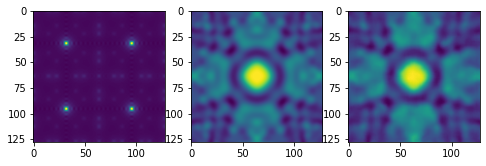

319
Log loss is:  17.8649607510466


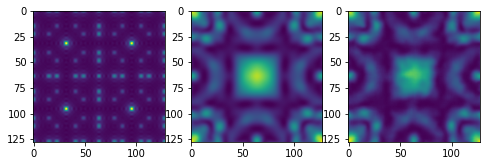

320
Log loss is:  10.074165212012737


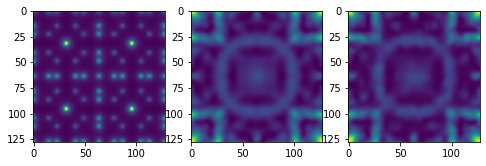

321
Log loss is:  8.866845630833325


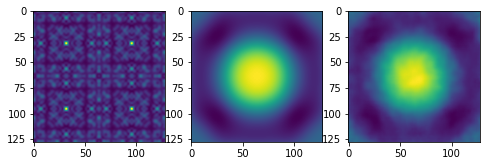

322
Log loss is:  50.855093093174794


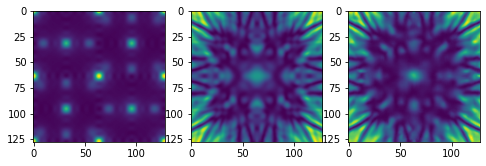

323
Log loss is:  153.1560060136902


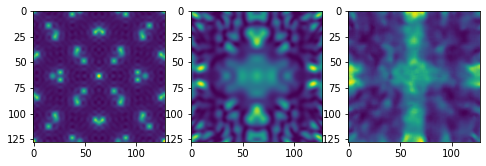

324
Log loss is:  43.506379680028225


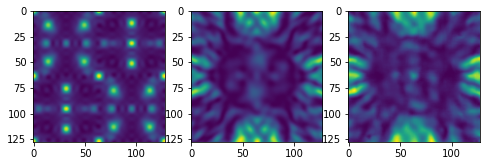

325
Log loss is:  266.4995054967512


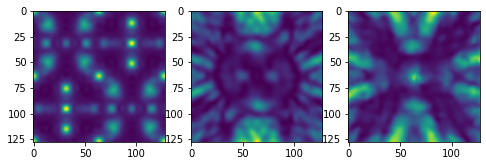

326
Log loss is:  314.6043253840896


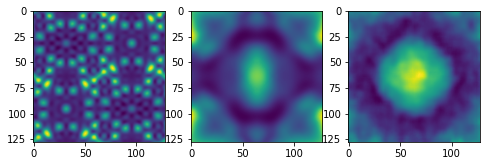

327
Log loss is:  57.213750510041145


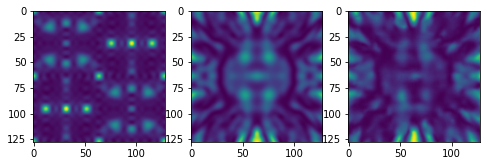

328
Log loss is:  928.6453594957514


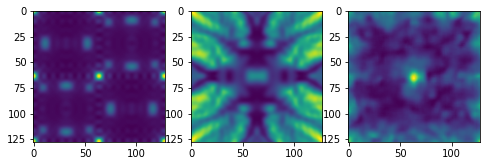

329
Log loss is:  124.1169541693054


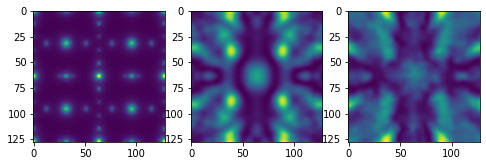

330
Log loss is:  80.92192251892456


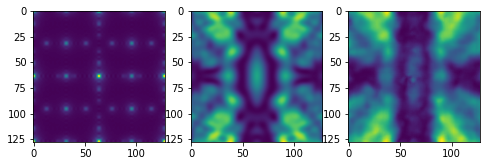

331
Log loss is:  100.96628890828606


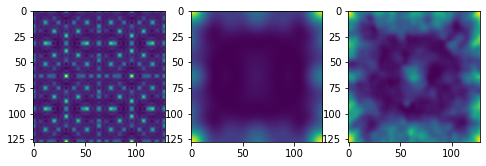

332
Log loss is:  134.61663601917434


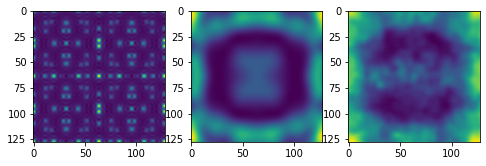

333
Log loss is:  38.27912996011344


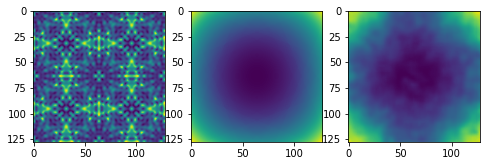

334
Log loss is:  150.47313607993618


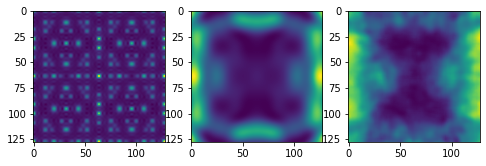

335
Log loss is:  245.8951079280093


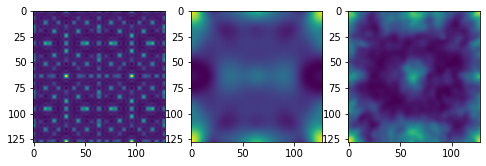

336
Log loss is:  1060.7660269953965


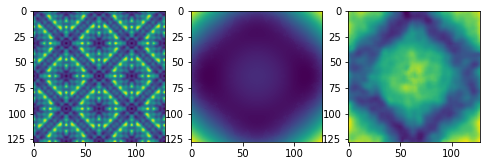

337
Log loss is:  22.017436528626043


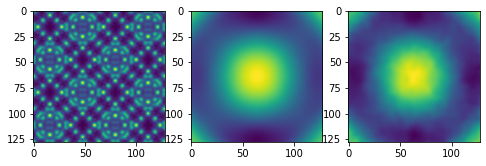

338
Log loss is:  40.4955302508191


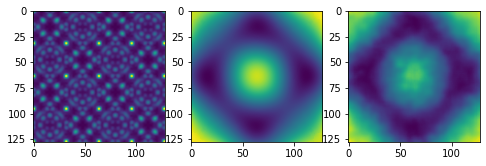

339
Log loss is:  84.64258569209886


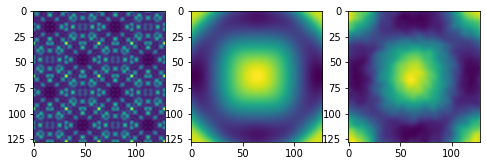

340
Log loss is:  208.06434424523002


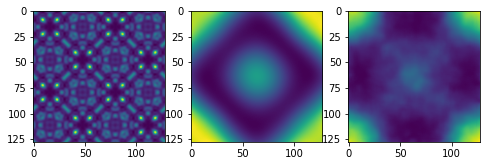

341
Log loss is:  79.58561000494025


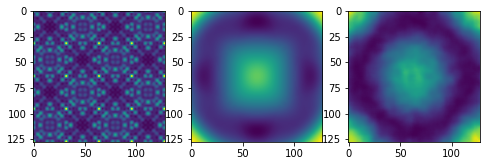

Average loss:  133.94832921261906


In [26]:
average_loss = 0
data = [i for i in gen_paths_labels(data_path)]
#data[0][0], data[0][1]
for i in range(0, len(data[0][0])):
    x = np.load(data[0][0][i])
    y = np.load(data[0][1][i])
    #x = np.load(data[0][i])
    #y = np.load(data[1][i])
    a = np.reshape(vae(np.reshape(x, (1, 128, 128, 1))), (128, 128))
    #print(i)
    log_loss = 0
    for j in range(0, a.shape[0]):
        for k in range(0, a.shape[1]):
            log_loss+=(math.log(1+a[j][k]) - math.log(1+y[j][k])) ** 2
    
    average_loss+=log_loss
    if log_loss > 0:
        print(i)
        print("Log loss is: ", log_loss)
        w=10
        h=10
        fig=plt.figure(figsize=(8, 8))
        columns = 3
        rows = 1
        fig.add_subplot(rows, columns, 1)
        plt.imshow(x)
        fig.add_subplot(rows, columns, 2)
        plt.imshow(y)
        fig.add_subplot(rows, columns, 3)
        plt.imshow(a)
        plt.show()
print("Average loss: ", average_loss / len(data[0][0]))

In [ ]:
for i in range(0, len(TrainingPaths[0])):
    #x = np.load(data[0][0][i])
    #y = np.load(data[0][1][i])
    x = np.load(TrainingPaths[0][i])
    y = np.load(TrainingPaths[1][i])
    a = np.reshape(vae(np.reshape(x, (1, 128, 128, 1))), (128, 128))
    print(TrainingPaths[0][i])

    w=10
    h=10
    fig=plt.figure(figsize=(8, 8))
    columns = 3
    rows = 1
    fig.add_subplot(rows, columns, 1)
    plt.imshow(x)
    fig.add_subplot(rows, columns, 2)
    plt.imshow(y)
    fig.add_subplot(rows, columns, 3)
    plt.imshow(a)
    plt.show()